<h2>Spatial Data Analysis - Coursework</h2>

<h3>Spatial analysis for 20-min Neighbourhood in London</h3>

<h4>Importing Libraries</h4>

In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from matplotlib.patches import Patch
from matplotlib import cm
import math
%matplotlib inline

import os
import urllib
import zipfile

import networkx as nx
import osmnx as ox
import folium
from folium import plugins
from folium.plugins import HeatMap, MarkerCluster, FastMarkerCluster
from shapely.ops import unary_union, nearest_points, transform
from shapely.geometry import Point, LineString, Polygon, MultiPolygon, GeometryCollection
from functools import partial
import pyproj

from mpl_toolkits.axes_grid1 import make_axes_locatable
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib_scalebar.scalebar import ScaleBar

from pointpats import PointPattern
from shapely.geometry import Point
import pointpats.quadrat_statistics as qs
from sklearn.neighbors import KernelDensity

import esda
import spreg
from spreg import OLS
from spreg import ML_Error
from spreg import ML_Lag
from sklearn.metrics import mean_squared_error as mse
from mgwr.gwr import GWR
from mgwr.sel_bw import Sel_BW

from pysal.lib import weights

from statsmodels.compat import lzip
import statsmodels.stats.api as sms

import warnings
warnings.simplefilter('ignore')


<h4>Prepare the data</h4>

PROJCS["OSGB36 / British National Grid",GEOGCS["OSGB36",DATUM["Ordnance_Survey_of_Great_Britain_1936",SPHEROID["Airy 1830",6377563.396,299.3249646,AUTHORITY["EPSG","7001"]],AUTHORITY["EPSG","6277"]],PRIMEM["Greenwich",0],UNIT["Degree",0.0174532925199433]],PROJECTION["Transverse_Mercator"],PARAMETER["latitude_of_origin",49],PARAMETER["central_meridian",-2],PARAMETER["scale_factor",0.999601272],PARAMETER["false_easting",400000],PARAMETER["false_northing",-100000],UNIT["metre",1,AUTHORITY["EPSG","9001"]],AXIS["Easting",EAST],AXIS["Northing",NORTH]]
EPSG:27700


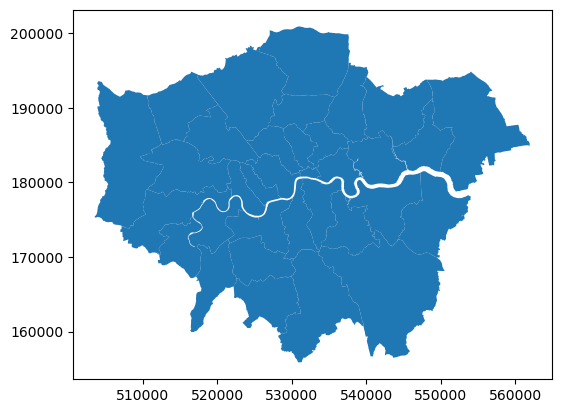

In [2]:
# London boroughs (If the calculation in LSOA level is too slow, we can use this as a substitute)
borough_path = os.path.join('data', 'London_Borough', 'London_Borough_Excluding_MHW.shp')
borough_gdf = gpd.read_file(borough_path)
print(borough_gdf.crs)
borough_gdf = borough_gdf.to_crs(epsg=27700)
print(borough_gdf.crs)
borough_gdf.plot()
borough_gdf_4326 = borough_gdf.to_crs(epsg=4326)

EPSG:27700


<Axes: >

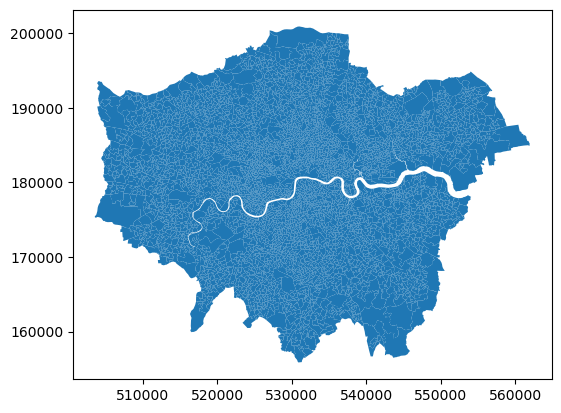

In [3]:
# London LSOA with IMD
lsoa_path = os.path.join('data', 'London_LSOA', 'LSOA_IMD2019.shp')
lsoa_gdf = gpd.read_file(lsoa_path)
print(lsoa_gdf.crs)
lsoa_gdf.plot()

EPSG:4326
479
EPSG:4326


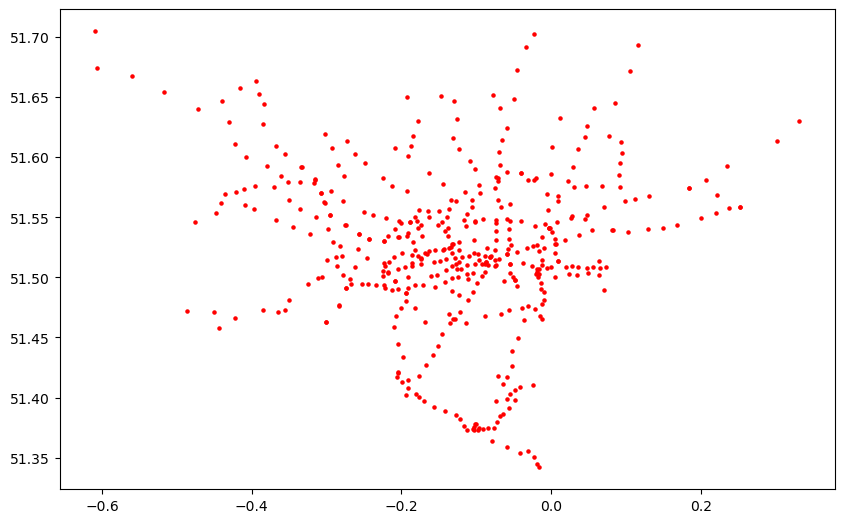

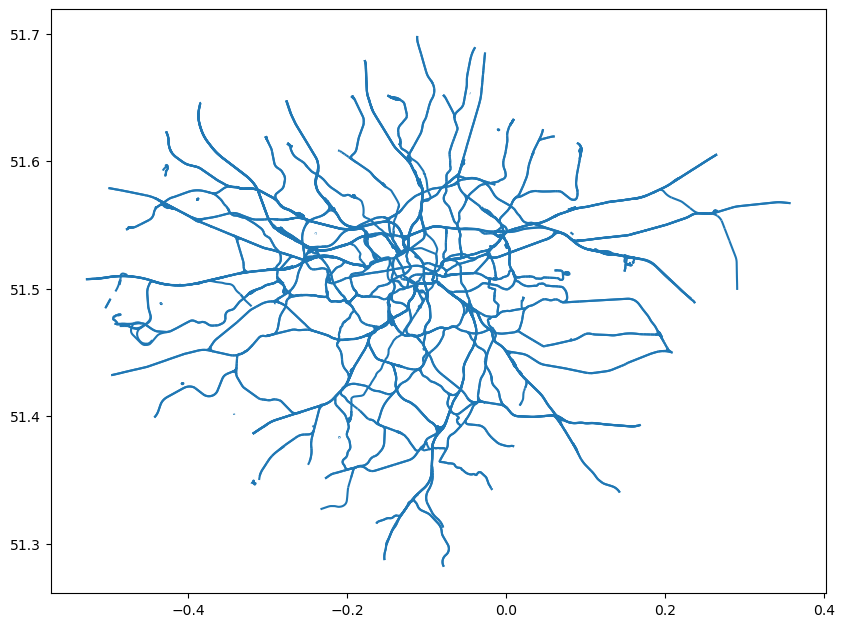

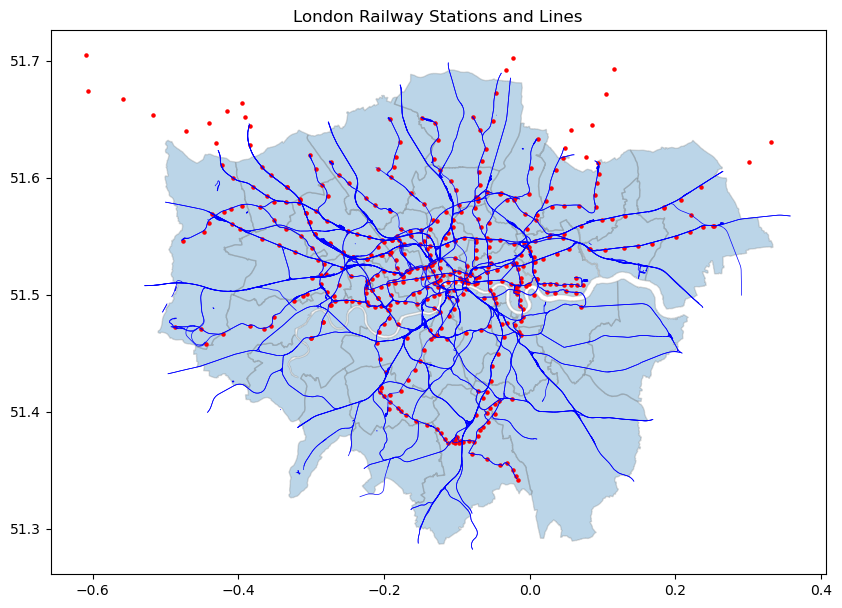

In [4]:
# London railway stations
railway_station_path = os.path.join('data', 'stations 2018.csv')
railway_station = gpd.read_file(railway_station_path)
railway_station['geometry'] = gpd.points_from_xy(railway_station['x'], railway_station['y'])
railway_station = railway_station.set_crs('EPSG:4326')
print(railway_station.crs)
print(len(railway_station))
railway_station.plot(markersize=5, color='red', figsize=(10,8))

# London railway lines
url  = 'https://github.com/cusp-london/Spatial-Data-Analysis/blob/master/railways.zip?raw=True'
railway_path = os.path.join("data","railways.zip")

r    = urllib.request.urlretrieve(url, railway_path)
z    = zipfile.ZipFile(railway_path)
m    = z.extractall("data")

railways = gpd.read_file('data/railways/gis_osm_railways.shp')
print(railways.crs)
railways.plot(figsize=(10,8))

# Plotting the railway stations and lines
fig, ax = plt.subplots(figsize=(10, 8))
borough_gdf_4326.plot(ax=ax, alpha=0.3, edgecolor='gray')
railways.plot(ax=ax, color='blue', linewidth=0.5)
railway_station.plot(ax=ax, markersize=5, color='red')
# ax.set_aspect('equal')
plt.title('London Railway Stations and Lines')
plt.show()


In [5]:
# snap railway stations to the nearest railway line

# convert CRS to projected coordinate system
railway_station = railway_station.to_crs(epsg=27700)
railways = railways.to_crs(epsg=27700)

# set the maximum distance to snap
max_distance = 150

def snap_station_to_line(station, lines, max_distance):
    station_point = station.geometry
    nearest_line = None
    min_distance = float('inf')
    
    for _, line in lines.iterrows():
        line_geom = line.geometry
        distance = station_point.distance(line_geom)
        
        if distance < min_distance:
            min_distance = distance
            nearest_line = line_geom
    
    if min_distance <= max_distance:
        nearest_point = nearest_points(station_point, nearest_line)[1]
        station.geometry = Point(nearest_point.x, nearest_point.y)
    else:
        station.geometry = None
    
    return station

# snap the railway stations to the nearest railway line and drop the stations that cannot be snapped
railway_station = railway_station.apply(lambda x: snap_station_to_line(x, railways, max_distance), axis=1)
railway_station = railway_station[railway_station.geometry.notnull()]
print(len(railway_station))

459


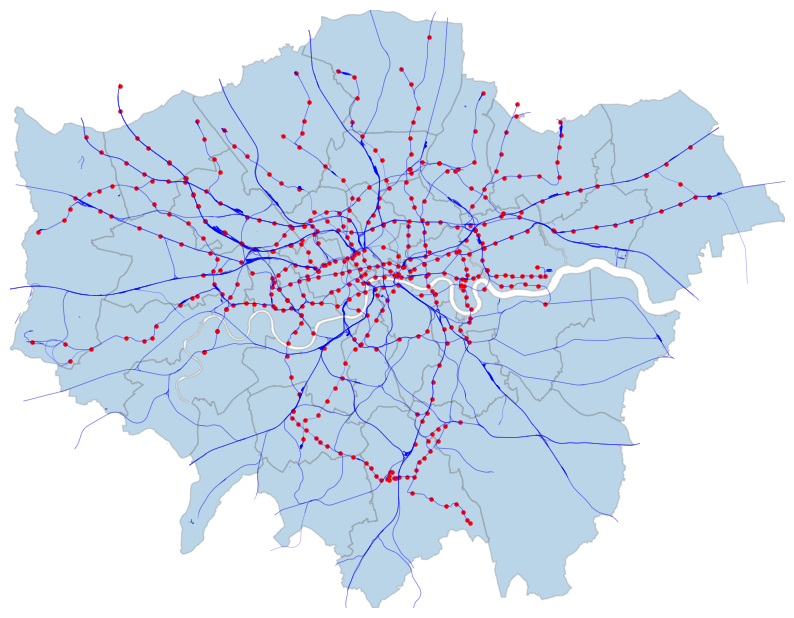

In [6]:
# plot the snapped railway stations and lines
fig, ax = plt.subplots(figsize=(10, 8))
borough_gdf.plot(ax=ax, alpha=0.3, edgecolor='gray')
railways.plot(ax=ax, alpha= 0.3, color='blue', linewidth=0.5)
railway_station.plot(ax=ax, markersize=5, color='red')

min_x, min_y, max_x, max_y = borough_gdf.total_bounds
ax.set_xlim(min_x, max_x)
ax.set_ylim(min_y, max_y)
ax.axis('off')  # turn off the axis
# plt.title('London Railway Stations (Snapped) and Lines')
plt.show()

epsg:4326
3923


<Axes: >

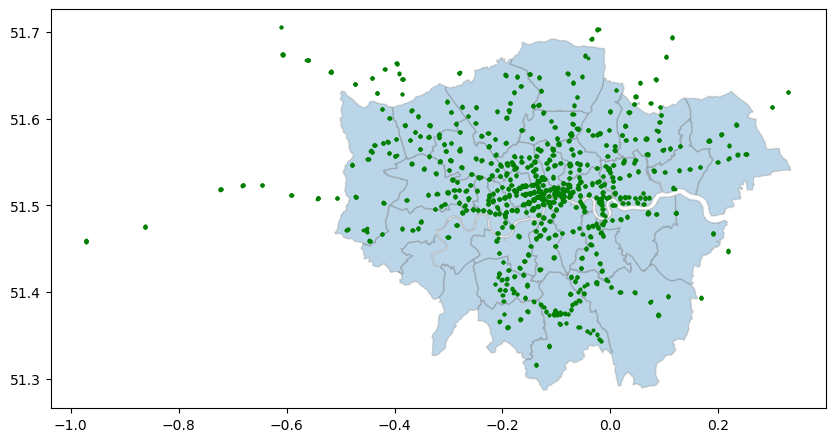

In [7]:
# London bus stops
url = 'https://api.tfl.gov.uk/stationdata/tfl-stationdata-detailed.zip'

# create a data directory if it doesn't exist
data_dir = 'data'
if not os.path.exists(data_dir):
    os.makedirs(data_dir)
zip_path = os.path.join(data_dir, 'tfl_stations.zip')

# download the data from the API
urllib.request.urlretrieve(url, zip_path)

# extract the zip file
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(os.path.join(data_dir, 'tfl_stations'))

# read the data
bus_stops = gpd.read_file(os.path.join(data_dir, 'tfl_stations\StationPoints.csv'))

bus_stops['geometry'] = gpd.points_from_xy(bus_stops['Lon'], bus_stops['Lat'])
bus_stops = bus_stops.set_crs('epsg:4326')
print(bus_stops.crs)
print(len(bus_stops))

fig, ax = plt.subplots(figsize=(10, 8))
borough_gdf_4326.plot(ax=ax, alpha=0.3, edgecolor='grey')
bus_stops.plot(ax=ax, markersize=3, color='green', figsize=(10,8))

<Axes: >

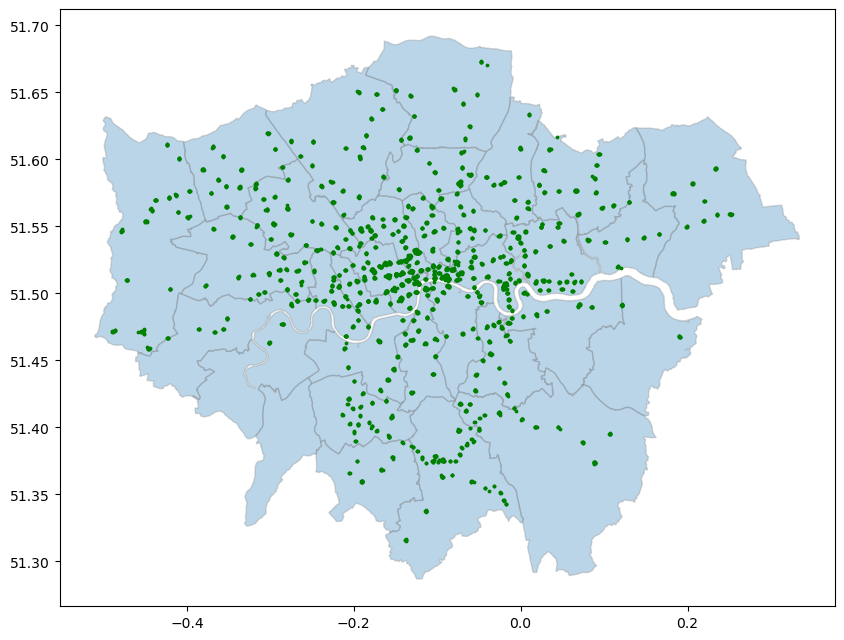

In [8]:
# drop the bus stops that are not within the boroughs
bus_stops = gpd.overlay(bus_stops, borough_gdf_4326, how='intersection')

fig, ax = plt.subplots(figsize=(10, 8))
borough_gdf_4326.plot(ax=ax, alpha=0.3, edgecolor='grey')
bus_stops.plot(ax=ax, markersize=3, color='green', figsize=(10,8))

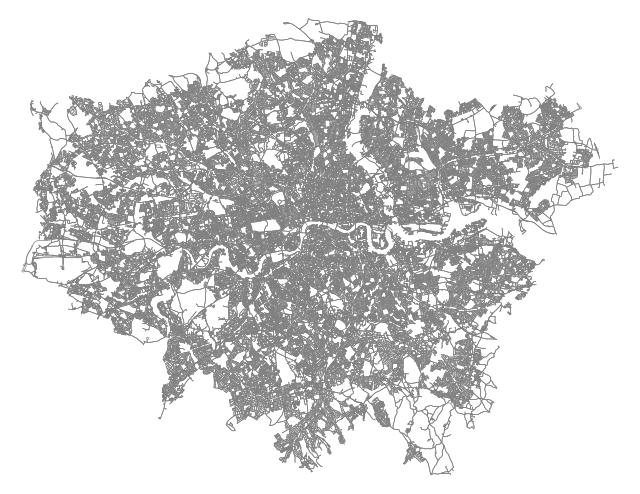

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [9]:
# London road network - drive
london_boundary = borough_gdf_4326.unary_union
ntw_drive = ox.graph_from_polygon(london_boundary, network_type='drive')
ox.plot_graph(ntw_drive, node_size=0, edge_linewidth=0.5, edge_color='gray', bgcolor='white')

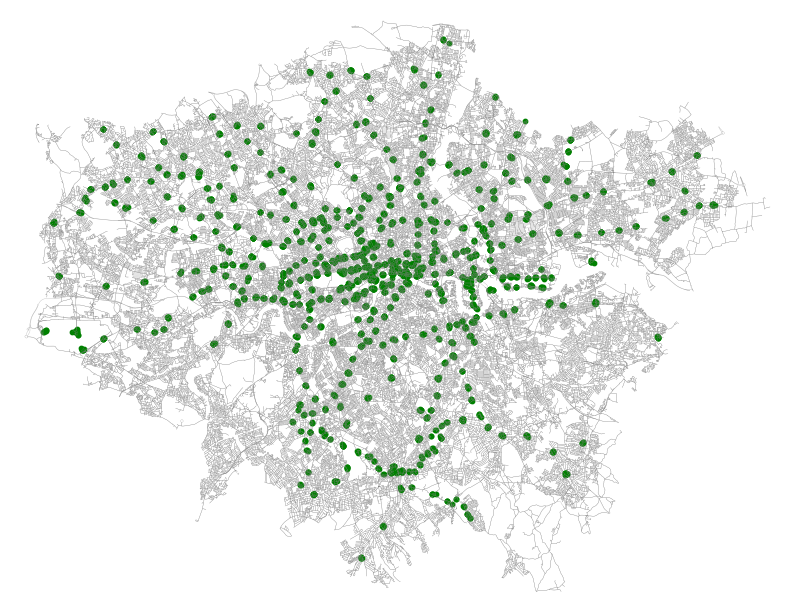

<Figure size 640x480 with 0 Axes>

In [10]:
# snap bus stops to driving network
max_distance = 50  #m
bus_stops = bus_stops.to_crs(ntw_drive.graph['crs'])

def snap_bus_stop_to_graph(bus_stop, graph_proj, max_distance):
    bus_stop_geometry = bus_stop.geometry
    nearest_node = ox.nearest_nodes(graph_proj, bus_stop_geometry.x, bus_stop_geometry.y)
    nearest_node_x = graph_proj.nodes[nearest_node]['x']
    nearest_node_y = graph_proj.nodes[nearest_node]['y']
    nearest_node_geometry = Point(nearest_node_x, nearest_node_y)

    if bus_stop_geometry.distance(nearest_node_geometry) <= max_distance:
        return nearest_node_geometry
    else:
        return None

# project the driving network
ntw_drive_proj = ox.project_graph(ntw_drive)
bus_stops = bus_stops.to_crs(ntw_drive_proj.graph['crs'])

snapped_bus_stops = []

for _, bus_stop in bus_stops.iterrows():
    snapped_geometry = snap_bus_stop_to_graph(bus_stop, ntw_drive_proj, max_distance)
    if snapped_geometry is not None:
        snapped_bus_stops.append({'geometry': snapped_geometry})

snapped_bus_stops_gdf = gpd.GeoDataFrame(snapped_bus_stops, crs=ntw_drive_proj.graph['crs'])


# plot the snapped bus stops
fig, ax = plt.subplots(figsize=(10, 8))

bus_stops_projected = bus_stops.to_crs(ntw_drive.graph['crs'])
bus_stops_projected.plot(ax=ax, markersize=10, color='green')

# plot the road network
ox.plot_graph(ntw_drive, ax=ax, node_size=0, edge_linewidth=0.2, edge_color='gray', edge_alpha=0.7)

ax.set_title('London Bus Stops and Road Network', fontsize=16)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.tight_layout()
plt.show()

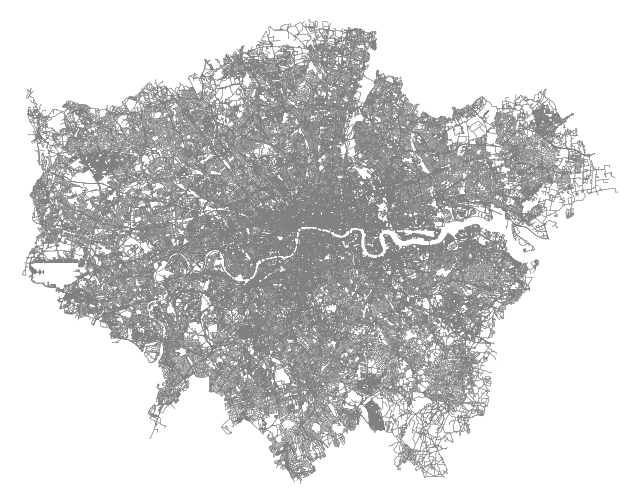

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [11]:
# London road network - walk
ntw_walk = ox.graph_from_polygon(london_boundary, network_type='walk')
ox.plot_graph(ntw_walk, node_size=0, edge_linewidth=0.3, edge_color='gray', bgcolor='white')

<h4>1. Accessibility for three means of green transportation (walk, bus, railway) - Isochrone map</h4>

In [12]:
# define the seeds in every borough and capture the seed on the road network
def get_center_node(borough_gdf, idx, ntw):
    borough_centroid = borough_gdf.loc[idx, 'geometry'].centroid
    center_node = ox.nearest_nodes(ntw, borough_centroid.x, borough_centroid.y)
    return center_node, Point(ntw.nodes[center_node]['x'], ntw.nodes[center_node]['y'])

In [13]:
# get the seeds in every borough
seeds = {}
for idx in borough_gdf.index:
    center_node, center_point = get_center_node(borough_gdf_4326, idx, ntw_walk)
    seeds[idx] = (center_node, center_point)

20-min walk accessibility

In [14]:
# define the time and speed for the isochrones
trip_times = [10, 20]
travel_speed_walk = 5  # km/h
travel_speed_bus = 20  # km/h

iso_colors = ['r', 'b']

In [15]:
def plot_isochrones_walk(borough_gdf_4326, trip_times, travel_speed_walk, seeds, iso_colors):
    isochrone_polys_walk = []
    isochrones_walk = gpd.GeoDataFrame()
    
    # number of rows and columns for the subplots
    n_boroughs = len(borough_gdf_4326)
    n_cols = 4
    n_rows = math.ceil(n_boroughs / n_cols)
    
    # create a subplots matrix
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 20))
    
    for idx, ax in zip(borough_gdf_4326.index, axes.flatten()):
        borough = borough_gdf_4326.loc[idx]
        print(f"Processing borough: {borough['NAME']} (Walk)")
        
        center_node, center_point = seeds[idx]
        G = ox.graph_from_polygon(borough['geometry'], network_type='walk')
        G_proj = ox.project_graph(G)
        
        meters_per_minute = travel_speed_walk * 1000 / 60
        for u, v, k, data in G_proj.edges(data=True, keys=True):
            data['time'] = data['length'] / meters_per_minute
        
        isochrone_polys = []
        for trip_time in sorted(trip_times, reverse=True):
            subgraph = nx.ego_graph(G_proj, center_node, radius=trip_time, distance='time')
            node_points = [Point((data['x'], data['y'])) for node, data in subgraph.nodes(data=True)]
            bounding_poly = gpd.GeoSeries(node_points).unary_union.convex_hull
            isochrone_polys.append(bounding_poly)
        isochrone_polys_walk.append(isochrone_polys)
        
        gdf = gpd.GeoDataFrame(geometry=isochrone_polys)
        isochrones_walk = pd.concat([isochrones_walk, gdf], ignore_index=False)
        
        ax.set_facecolor('w')
        ox.plot_graph(G_proj, ax=ax, show=False, close=False, edge_color='gray', edge_alpha=0.3, node_color='none', edge_linewidth=0.4)
        gdf.plot(ax=ax, color=iso_colors, ec="none", alpha=0.7, zorder=-1)
        ax.set_title(f"{borough['NAME']}", fontsize=14)
        
    # remove empty subplots
    for ax in axes.flatten()[n_boroughs:]:
        ax.axis('off')
        
    # add a title and legend
    fig.suptitle("Isochrones for London Boroughs (Walk Network)", fontsize=20)
    
    legend_elements = [Patch(facecolor='red', edgecolor='none', label='20 min isochrone'),
                       Patch(facecolor='blue', edgecolor='none', label='10 min isochrone')]
    fig.legend(handles=legend_elements, loc='lower center', ncol=2, fontsize=14, bbox_to_anchor=(0.5, -0.01))
    
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()
    
    return isochrone_polys_walk, isochrones_walk

Processing borough: Kingston upon Thames (Walk)
Processing borough: Croydon (Walk)
Processing borough: Bromley (Walk)
Processing borough: Hounslow (Walk)
Processing borough: Ealing (Walk)
Processing borough: Havering (Walk)
Processing borough: Hillingdon (Walk)
Processing borough: Harrow (Walk)
Processing borough: Brent (Walk)
Processing borough: Barnet (Walk)
Processing borough: Lambeth (Walk)
Processing borough: Southwark (Walk)
Processing borough: Lewisham (Walk)
Processing borough: Greenwich (Walk)
Processing borough: Bexley (Walk)
Processing borough: Enfield (Walk)
Processing borough: Waltham Forest (Walk)
Processing borough: Redbridge (Walk)
Processing borough: Sutton (Walk)
Processing borough: Richmond upon Thames (Walk)
Processing borough: Merton (Walk)
Processing borough: Wandsworth (Walk)
Processing borough: Hammersmith and Fulham (Walk)
Processing borough: Kensington and Chelsea (Walk)
Processing borough: Westminster (Walk)
Processing borough: Camden (Walk)
Processing boroug

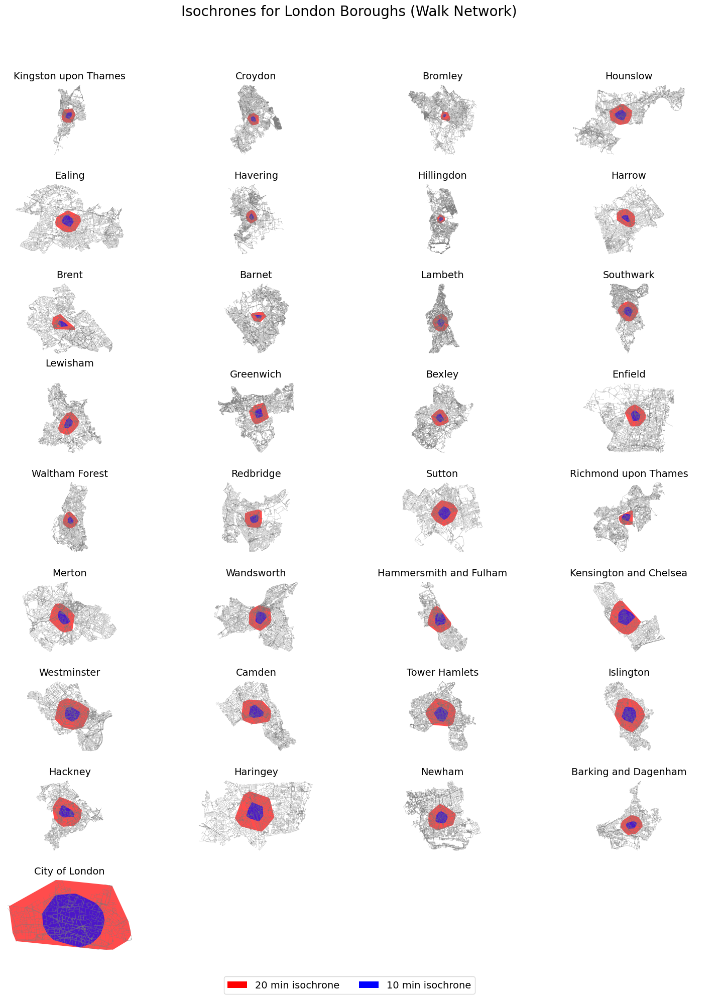

In [16]:
isochrone_polys_walk, isochrones_walk = plot_isochrones_walk(borough_gdf_4326, trip_times, travel_speed_walk, seeds, iso_colors)

In [17]:
# get the walking road network within 20-min isochrones
def extract_walk_networks_within_20min_isochrones(borough_gdf_4326, travel_speed_walk, seeds):
    walk_node_networks = {}
    walk_edge_networks = {}
    
    for idx, borough in borough_gdf_4326.iterrows():
        print(f"Processing borough: {borough['NAME']} (Walk)")
        
        center_node, center_point = seeds[idx]
        G = ox.graph_from_polygon(borough['geometry'], network_type='walk')
        G_proj = ox.project_graph(G)
        
        meters_per_minute = travel_speed_walk * 1000 / 60
        for u, v, k, data in G_proj.edges(data=True, keys=True):
            data['time'] = data['length'] / meters_per_minute
        
        subgraph = nx.ego_graph(G_proj, center_node, radius=20, distance='time')
        node_points = [Point((data['x'], data['y'])) for node, data in subgraph.nodes(data=True)]
        bounding_poly = gpd.GeoSeries(node_points).unary_union.convex_hull
        
        bounding_poly_gseries = gpd.GeoSeries([bounding_poly], crs=G_proj.graph['crs'])
        bounding_poly_4326 = bounding_poly_gseries.to_crs(epsg=4326)
        borough_gdf_4326.at[idx, 'area_20min_walk'] = bounding_poly_4326.area[0]
        borough_gdf_4326.at[idx, 'area'] = borough['geometry'].area
        borough_gdf_4326.at[idx, 'area_ratio'] = round(borough_gdf_4326.at[idx, 'area_20min_walk'] / borough_gdf_4326.at[idx, 'area'], 4)
        borough_gdf_4326['access_index'] = round(borough_gdf_4326['area_20min_walk']*10**3, 2)

        walk_node_network = ox.graph_from_polygon(bounding_poly_4326[0], network_type='walk')
        walk_edge_network = nx.line_graph(walk_node_network)
        
        walk_node_networks[borough['NAME']] = walk_node_network
        walk_edge_networks[borough['NAME']] = walk_edge_network
    
    return walk_node_networks, walk_edge_networks, borough_gdf_4326

In [18]:
walk_node_networks, walk_edge_networks, borough_gdf_4326 = extract_walk_networks_within_20min_isochrones(borough_gdf_4326, travel_speed_walk, seeds)

Processing borough: Kingston upon Thames (Walk)


Processing borough: Croydon (Walk)
Processing borough: Bromley (Walk)
Processing borough: Hounslow (Walk)
Processing borough: Ealing (Walk)
Processing borough: Havering (Walk)
Processing borough: Hillingdon (Walk)
Processing borough: Harrow (Walk)
Processing borough: Brent (Walk)
Processing borough: Barnet (Walk)
Processing borough: Lambeth (Walk)
Processing borough: Southwark (Walk)
Processing borough: Lewisham (Walk)
Processing borough: Greenwich (Walk)
Processing borough: Bexley (Walk)
Processing borough: Enfield (Walk)
Processing borough: Waltham Forest (Walk)
Processing borough: Redbridge (Walk)
Processing borough: Sutton (Walk)
Processing borough: Richmond upon Thames (Walk)
Processing borough: Merton (Walk)
Processing borough: Wandsworth (Walk)
Processing borough: Hammersmith and Fulham (Walk)
Processing borough: Kensington and Chelsea (Walk)
Processing borough: Westminster (Walk)
Processing borough: Camden (Walk)
Processing borough: Tower Hamlets (Walk)
Processing borough: Isli

20-min bus accessibility

In [19]:
# snap the seeds to the driving network
seeds_drive = seeds = {}
for idx in borough_gdf.index:
    center_node, center_point = get_center_node(borough_gdf_4326, idx, ntw_drive)
    seeds_drive[idx] = (center_node, center_point)

In [23]:
trip_time = 20 #min

def plot_isochrones_bus(borough_gdf_4326, trip_time, travel_speed_bus, travel_speed_walk, seeds_drive, snapped_bus_stops_gdf):
    isochrone_polys_bus = []
    
    # convert the crs
    snapped_bus_stops_gdf = snapped_bus_stops_gdf.to_crs(borough_gdf_4326.crs)
    
    # number of rows and colums
    n_boroughs = len(borough_gdf_4326)
    n_cols = 4
    n_rows = math.ceil(n_boroughs / n_cols)
    
    # subplots matrix
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 20))
    
    for idx, ax in zip(borough_gdf_4326.index, axes.flatten()):
        borough = borough_gdf_4326.loc[[idx]]  # select borough individually
        print(f"Processing borough: {borough['NAME'].iloc[0]} (Bus)")
        
        center_point = seeds_drive[idx][1]
        
        # create walking graph for the borough
        walking_graph = ox.graph_from_polygon(borough.geometry.iloc[0], network_type='walk')
        walking_graph_proj = ox.project_graph(walking_graph)
        
        # find bus stops within the borough
        borough_bus_stops = snapped_bus_stops_gdf[snapped_bus_stops_gdf.within(borough.geometry.iloc[0])]
        if borough_bus_stops.empty:
            # if there is no bus stop, draw the boundary and the seed
            ax.set_facecolor('w')
            borough.plot(ax=ax, edgecolor='k', facecolor='none', linestyle='-', linewidth=1.0)
            ax.scatter(center_point.x, center_point.y, color='red', s=100, marker='*', zorder=2)  # seed
            ax.set_title(f"{borough['NAME'].iloc[0]}", fontsize=14)
            ax.axis('off')
            continue
        
        # find the nearest node in the graph to the center point
        center_node = ox.distance.nearest_nodes(walking_graph_proj, center_point.x, center_point.y)

        # find the nearest bus stop
        nearest_stop = nearest_points(borough_bus_stops.geometry.unary_union, center_point)[0]
        nearest_stop_idx = borough_bus_stops.distance(nearest_stop).idxmin()

        # find the nearest node in the graph to the nearest bus stop
        nearest_stop_node = ox.distance.nearest_nodes(walking_graph_proj, nearest_stop.x, nearest_stop.y)

        # calculate walking time from the seed to the nearest bus stop
        walk_time = nx.dijkstra_path_length(walking_graph_proj, center_node, nearest_stop_node) / travel_speed_walk * 60  # in minutes
        
        if walk_time >= 20:
            # if walking time is greater than or equal to 20 minutes, draw the boundary, the seed, and the nearest bus stop
            ax.set_facecolor('w')
            borough.plot(ax=ax, edgecolor='k', facecolor='none', linestyle='-', linewidth=1.0)
            ax.scatter(center_point.x, center_point.y, color='green', s=100, marker='*', zorder=2)  # seed
            ax.scatter(nearest_stop.x, nearest_stop.y, color='blue', s=50, marker='o', zorder=2)  # nearest bus stop
            ax.set_title(f"{borough['NAME'].iloc[0]}", fontsize=14)
            ax.axis('off')
            continue
        
        # calculate the remaining trip time by bus
        trip_time_bus = trip_time - walk_time
        
        # calculate the maximum distance
        max_distance = trip_time_bus * travel_speed_bus * 1000 / 60
        
        # create isochrone polygons based on the nearest bus stop
        isochrone_poly = borough_bus_stops.loc[nearest_stop_idx].geometry.buffer(max_distance)
        isochrone_poly = isochrone_poly.intersection(borough.geometry.iloc[0])  # ensure the isochrone is within the borough
        isochrone_polys_bus.append(isochrone_poly)
        
        gdf = gpd.GeoDataFrame(geometry=[isochrone_poly], crs=borough_gdf_4326.crs)
        
        ax.set_facecolor('w')
        borough.plot(ax=ax, edgecolor='k', facecolor='none', linestyle='-', linewidth=1.0)
        ax.scatter(center_point.x, center_point.y, color='green', s=100, marker='*', zorder=2)  # seed
        ax.scatter(nearest_stop.x, nearest_stop.y, color='blue', s=50, marker='o', zorder=2)  # nearest bus stop
        gdf.plot(ax=ax, color='red', ec="none", alpha=0.4, zorder=1)
        ax.set_title(f"{borough['NAME'].iloc[0]}", fontsize=14)
        ax.axis('off')
        
    # remove empty subplots
    for ax in axes.flatten()[n_boroughs:]:
        ax.axis('off')
        
    # add title and legend
    fig.suptitle("Isochrones for London Boroughs (Bus Network)", fontsize=20)
    
    legend_elements = [Patch(facecolor='red', edgecolor='none', label=f'{trip_time} min Isochrone'),
                       Line2D([0], [0], marker='o', color='w', label='Nearest Bus Stop', markerfacecolor='blue', markersize=10),
                       Line2D([0], [0], marker='*', color='w', label='Seed', markerfacecolor='green', markersize=10)]
    fig.legend(handles=legend_elements, loc='lower center', ncol=4, fontsize=12, bbox_to_anchor=(0.5, -0.01))
    
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()
        
    bus_20min_poly = gpd.GeoSeries(isochrone_polys_bus).unary_union
    bus_20min_poly = bus_20min_poly.simplify(tolerance=500)  # simplify the geometry

    return bus_20min_poly

Processing borough: Kingston upon Thames (Bus)
Processing borough: Croydon (Bus)
Processing borough: Bromley (Bus)
Processing borough: Hounslow (Bus)
Processing borough: Ealing (Bus)
Processing borough: Havering (Bus)
Processing borough: Hillingdon (Bus)
Processing borough: Harrow (Bus)
Processing borough: Brent (Bus)
Processing borough: Barnet (Bus)
Processing borough: Lambeth (Bus)
Processing borough: Southwark (Bus)
Processing borough: Lewisham (Bus)
Processing borough: Greenwich (Bus)
Processing borough: Bexley (Bus)
Processing borough: Enfield (Bus)
Processing borough: Waltham Forest (Bus)
Processing borough: Redbridge (Bus)
Processing borough: Sutton (Bus)
Processing borough: Richmond upon Thames (Bus)
Processing borough: Merton (Bus)
Processing borough: Wandsworth (Bus)
Processing borough: Hammersmith and Fulham (Bus)
Processing borough: Kensington and Chelsea (Bus)
Processing borough: Westminster (Bus)
Processing borough: Camden (Bus)
Processing borough: Tower Hamlets (Bus)
Pro

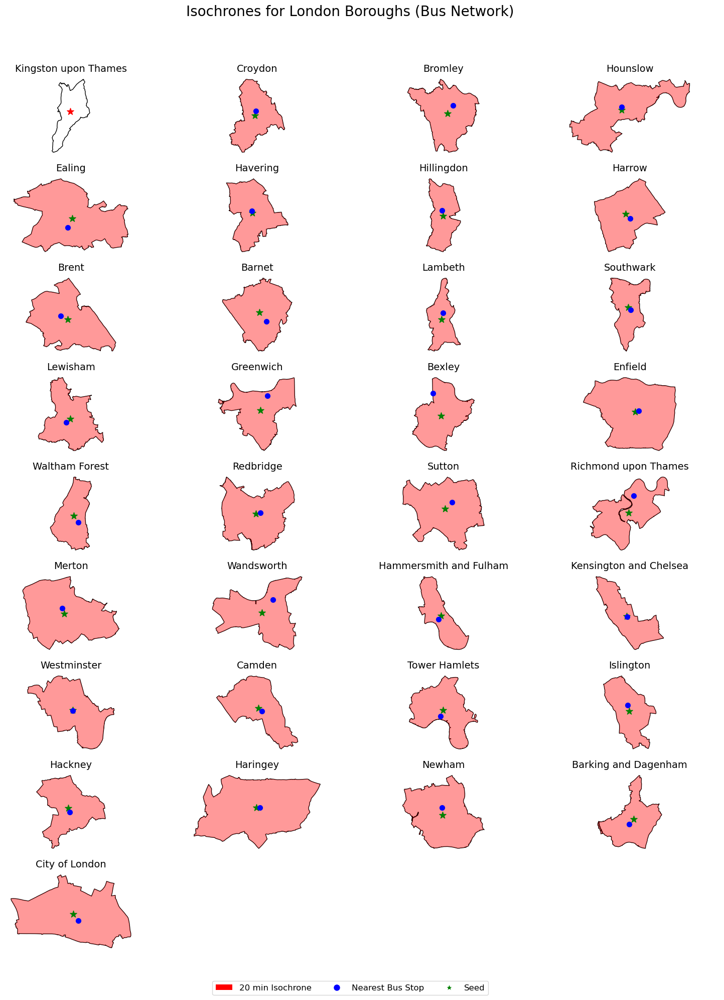

In [24]:
bus_20min_poly = plot_isochrones_bus(borough_gdf_4326, trip_time, travel_speed_bus, travel_speed_walk, seeds_drive, snapped_bus_stops_gdf)

<h4>2. Well-connected roads - network centrality</h4>

In [25]:
borough_gdf_4326.head(3)

,NAME,GSS_CODE,HECTARES,NONLD_AREA,ONS_INNER,SUB_2009,SUB_2006,geometry,area_20min_walk,area,area_ratio,access_index
0,Kingston upon Thames,E09000021,3726.117,0.0,F,None,None,"POLYGON ((-0.33066 51.32901, -0.33057 51.32909...",0.000633,0.004813,0.1316,0.63
1,Croydon,E09000008,8649.441,0.0,F,None,None,"POLYGON ((-0.06399 51.31864, -0.06405 51.31861...",0.000650,0.011164,0.0582,0.65
2,Bromley,E09000006,15013.487,0.0,F,None,None,"POLYGON ((0.01216 51.29960, 0.01199 51.29979, ...",0.000509,0.019384,0.0263,0.51


In [26]:
def analyze_centrality_in_boroughs(walk_node_networks, walk_edge_networks):
    centrality_results = {}
    
    # create an output folder
    output_folder = "./pic/centrality_plots"
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    for borough_name in walk_node_networks.keys():
        print(f"Processing borough: {borough_name}")
        
        walk_node_network = walk_node_networks[borough_name]
        walk_edge_network = walk_edge_networks[borough_name]
        
        # node centrality
        node_centrality = nx.closeness_centrality(walk_node_network)
        
        # edge centrality
        edge_centrality = nx.closeness_centrality(walk_edge_network)
        
        centrality_results[borough_name] = {
            'node_closeness_centrality': node_centrality,
            'edge_closeness_centrality': edge_centrality
        }
        
        # plot and save node centrality
        df = pd.DataFrame(data=pd.Series(node_centrality).sort_values(), columns=['cc'])
        df['colors'] = ox.plot.get_colors(n=len(df), cmap='inferno', start=0.2)
        df = df.reindex(walk_node_network.nodes())
        nc = df['colors'].tolist()
        
        title1 = f"Node Closeness Centrality - {borough_name}"
        ox.plot.plot_graph(walk_node_network, bgcolor='k', node_size=15, node_color=nc, node_edgecolor='none', node_zorder=2,
                           edge_color='#555555', edge_linewidth=2, edge_alpha=0.8, show=True, close=True,
                           save=True, filepath=os.path.join(output_folder, f"{title1}.png"))
        
        # plot and save edge centrality
        ev = [edge_centrality[edge + (0,)] for edge in walk_node_network.edges()]
        norm = mpl.colors.Normalize(vmin=min(ev)*0.8, vmax=max(ev))
        cmap = cm.ScalarMappable(norm=norm, cmap=cm.inferno)
        ec = [cmap.to_rgba(cl) for cl in ev]
        
        title2 = f"Edge Closeness Centrality - {borough_name}"
        ox.plot.plot_graph(walk_node_network, bgcolor='k', node_size=0, node_color='w', node_edgecolor='gray', node_zorder=2,
                           edge_color=ec, edge_linewidth=2, edge_alpha=0.8, show=True, close=True,
                           save=True, filepath=os.path.join(output_folder, f"{title2}.png"))
        
    return centrality_results

In [27]:
# test_node = {}
# test_edge = {}

# test_node['Kingston upon Thames'] = walk_node_networks['Kingston upon Thames']
# test_edge['Kingston upon Thames'] = walk_edge_networks['Kingston upon Thames']

# centrality_results = analyze_centrality_in_boroughs(test_node, test_edge)

Processing borough: Kingston upon Thames


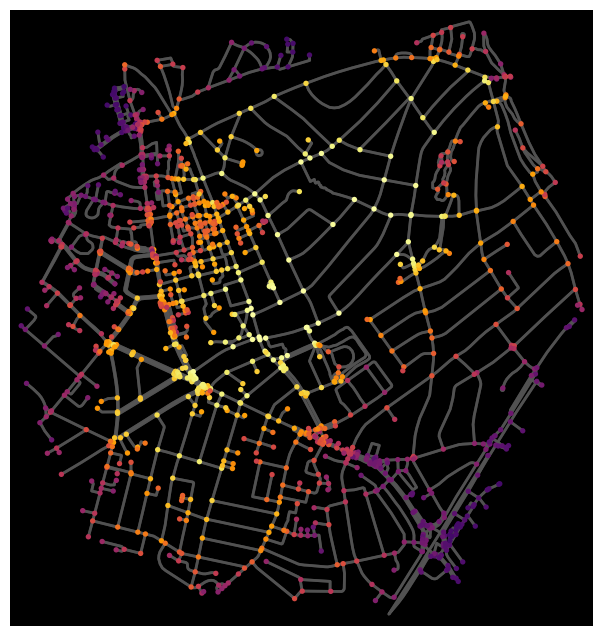

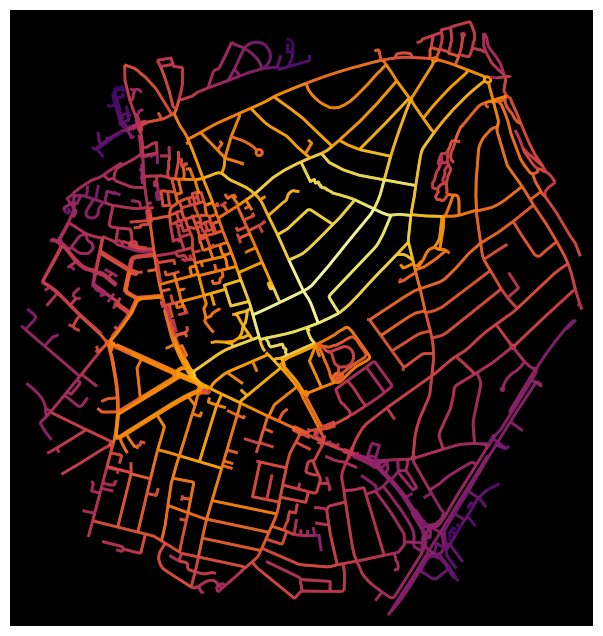

Processing borough: Croydon


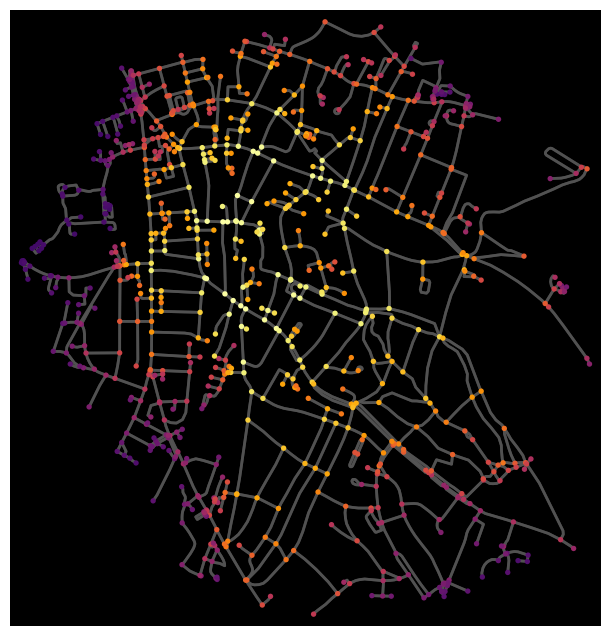

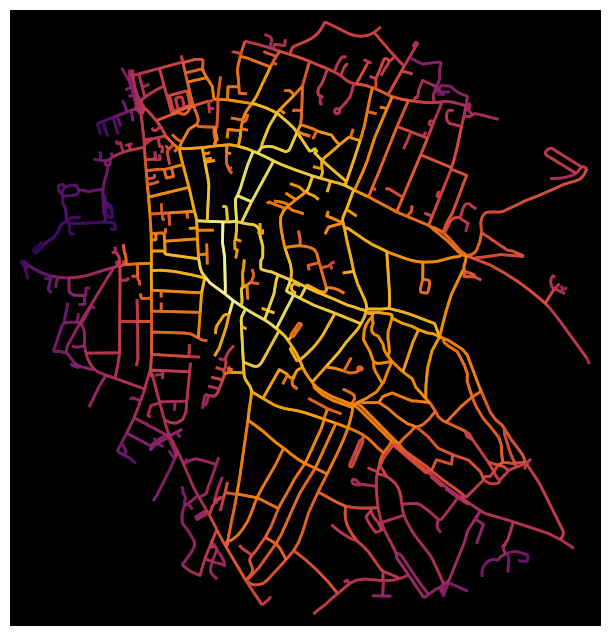

Processing borough: Bromley


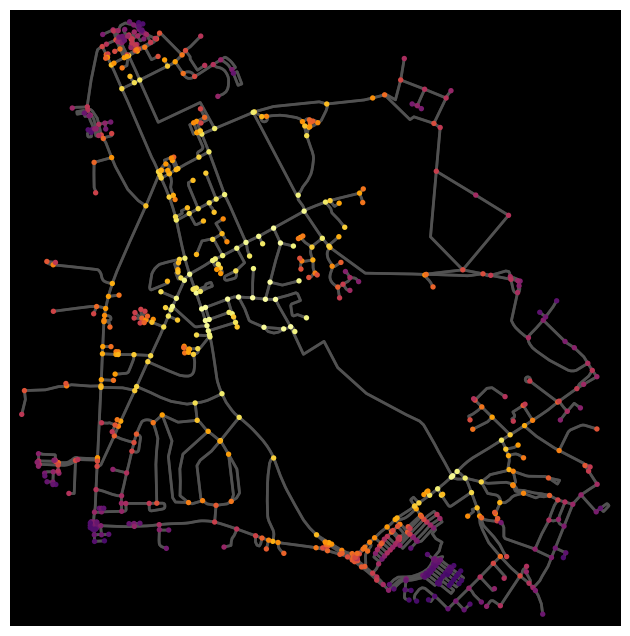

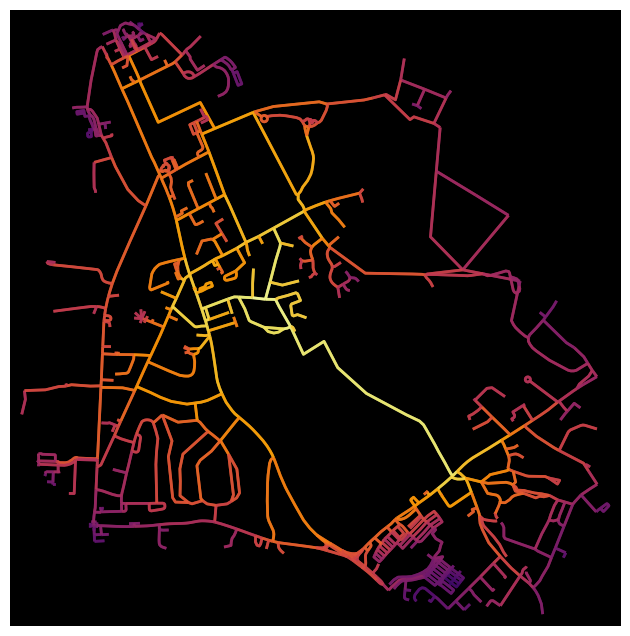

Processing borough: Hounslow


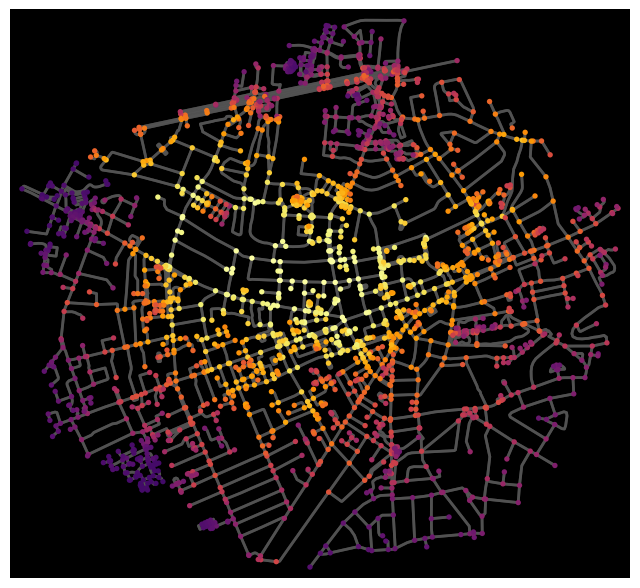

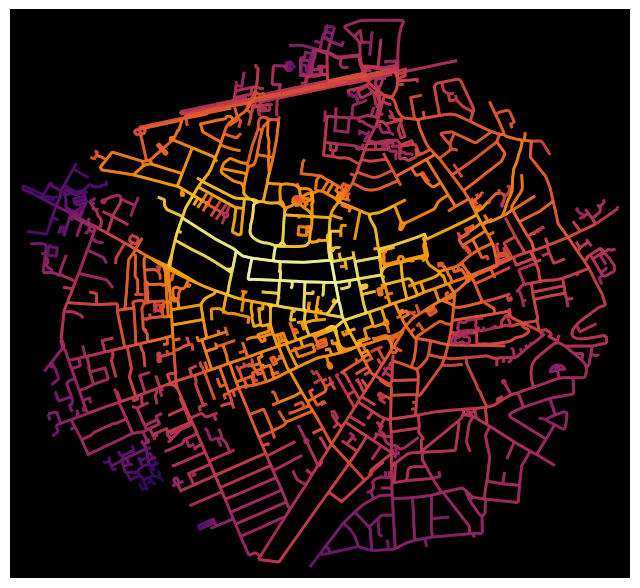

Processing borough: Ealing


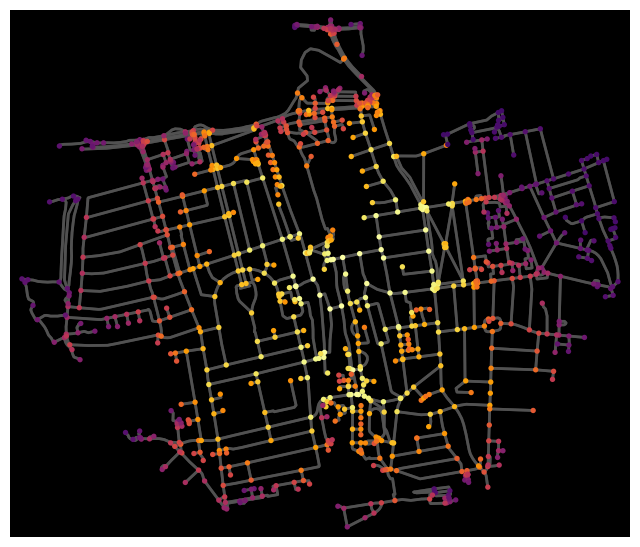

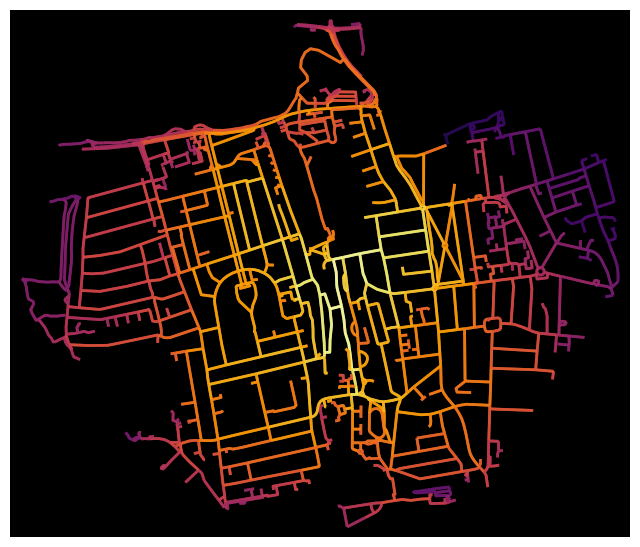

Processing borough: Havering


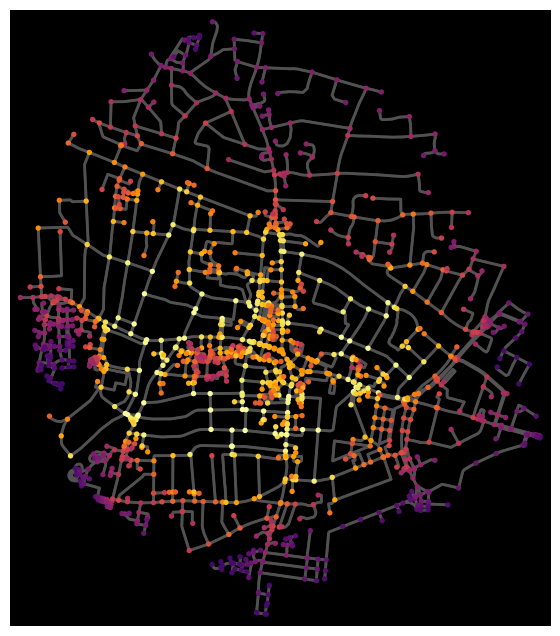

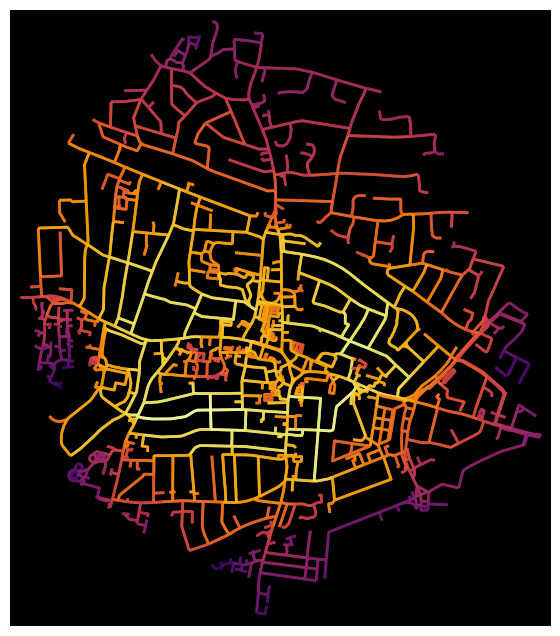

Processing borough: Hillingdon


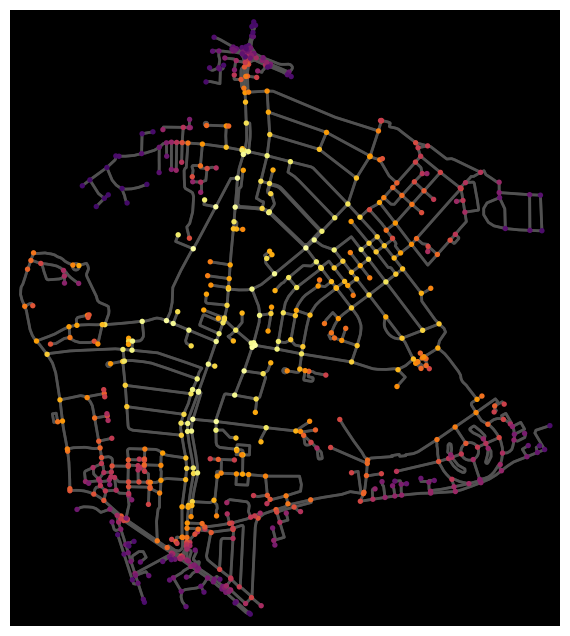

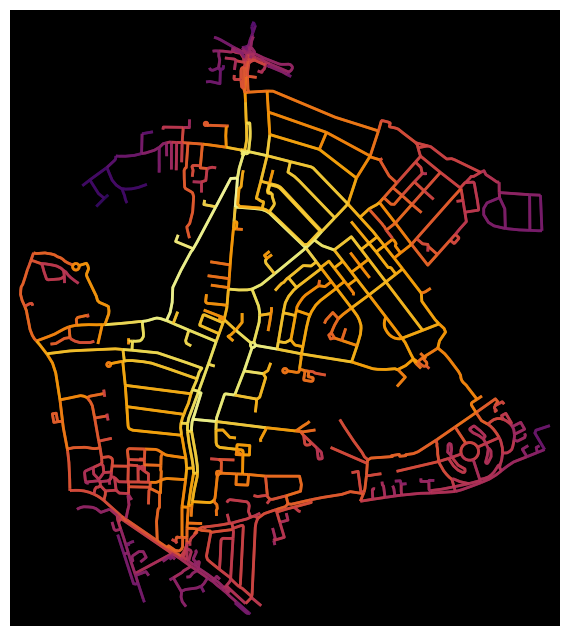

Processing borough: Harrow


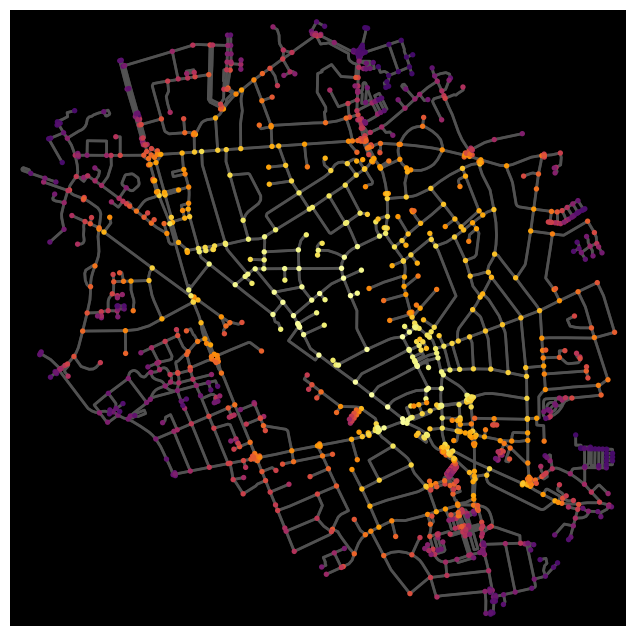

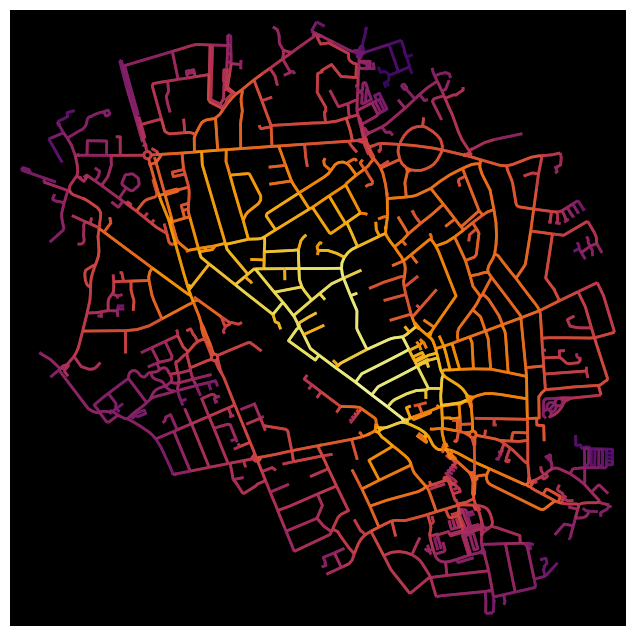

Processing borough: Brent


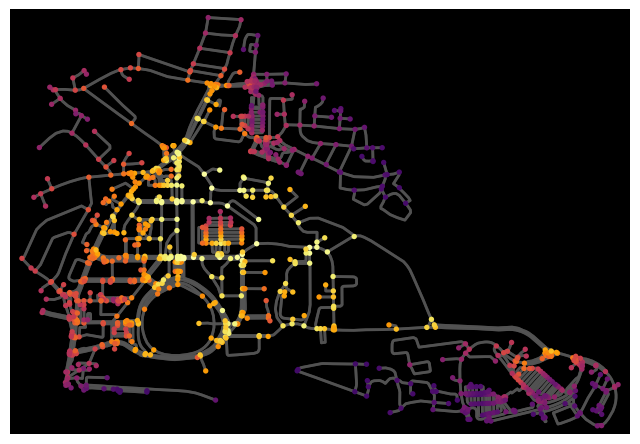

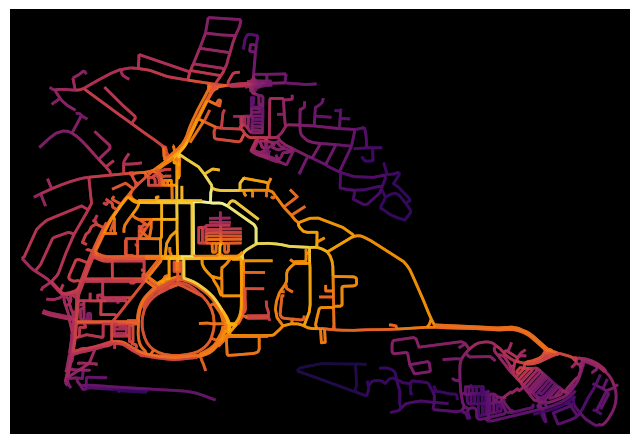

Processing borough: Barnet


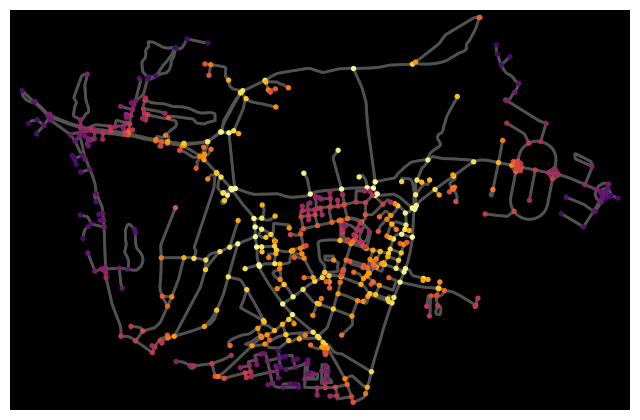

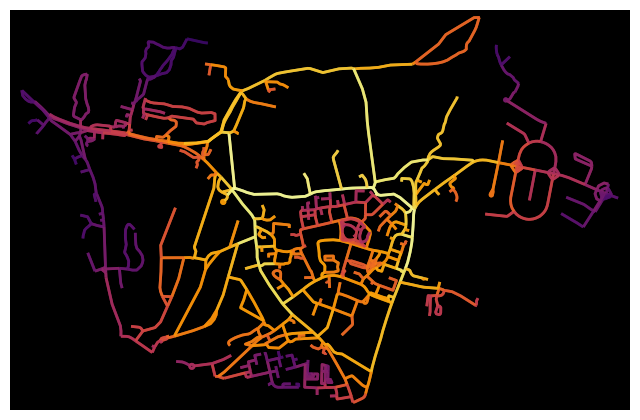

Processing borough: Lambeth


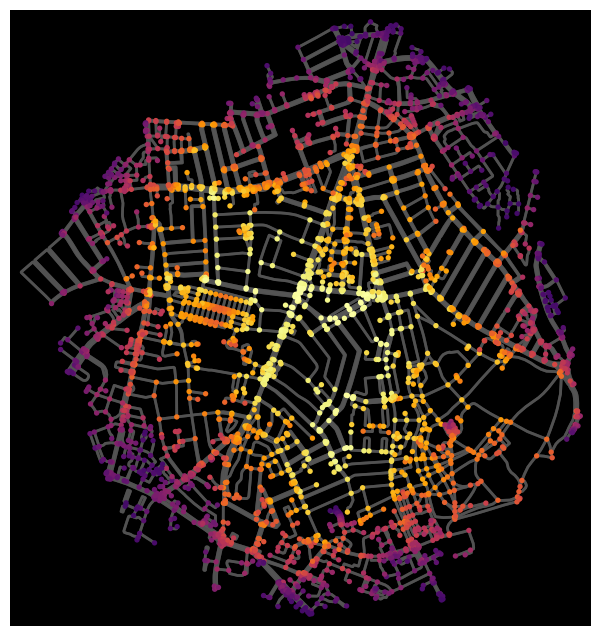

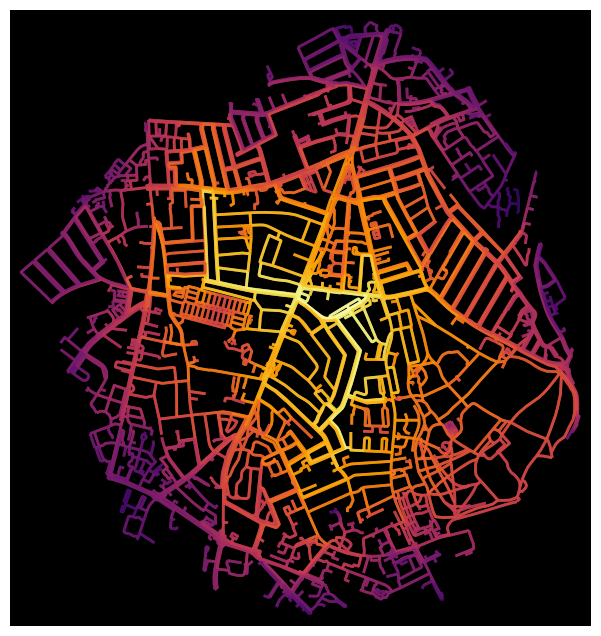

Processing borough: Southwark


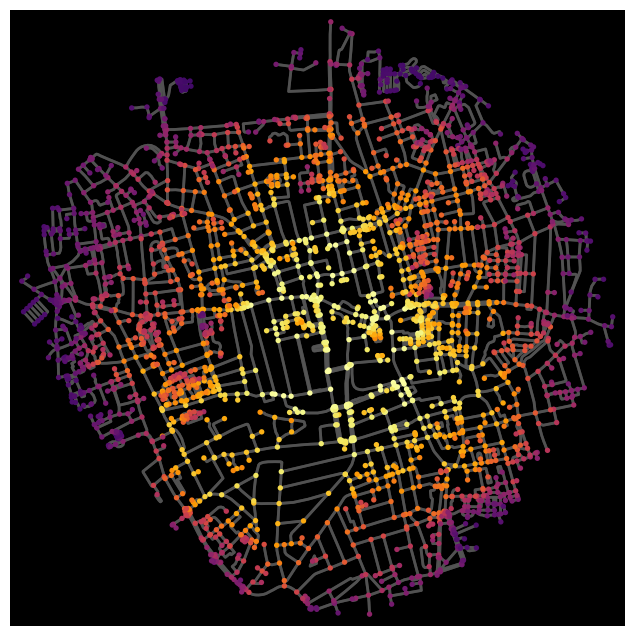

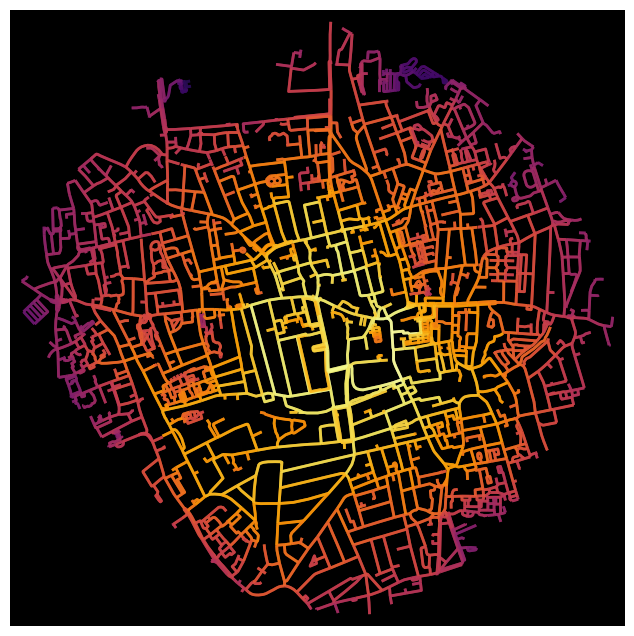

Processing borough: Lewisham


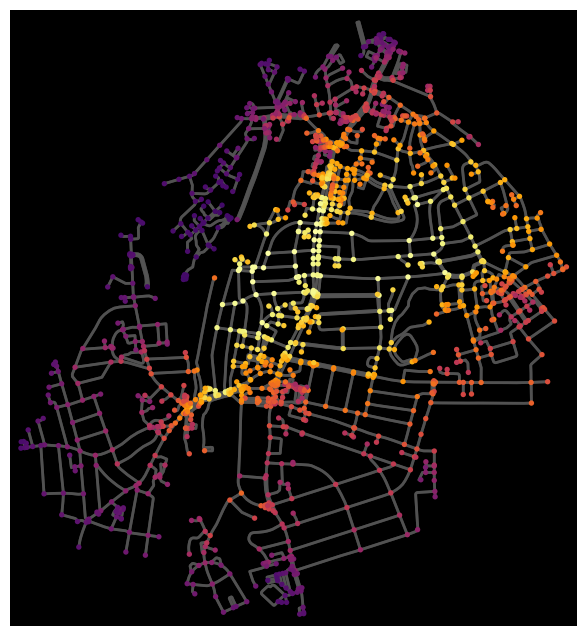

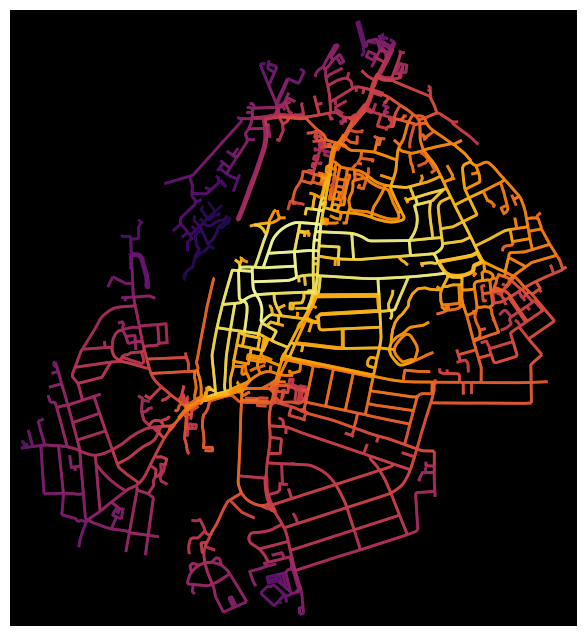

Processing borough: Greenwich


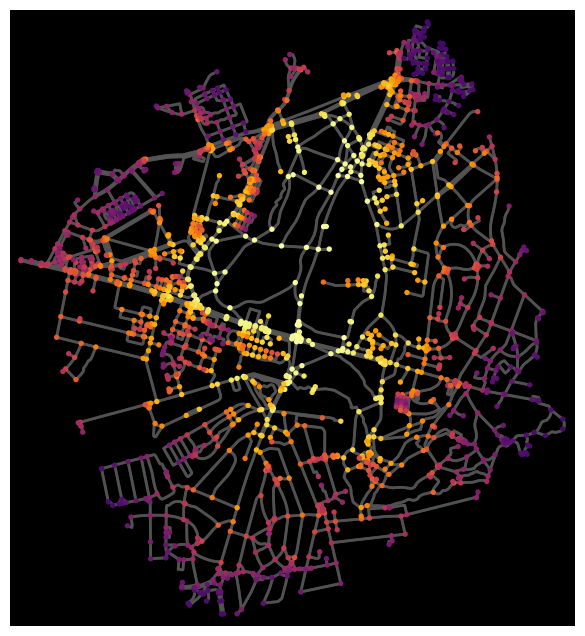

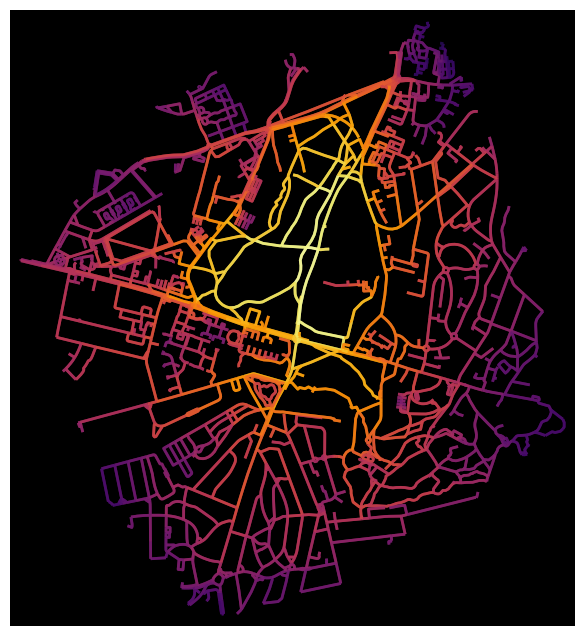

Processing borough: Bexley


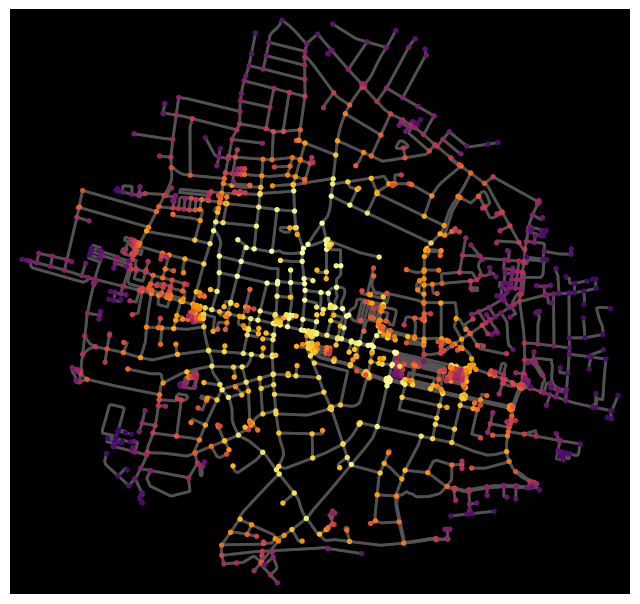

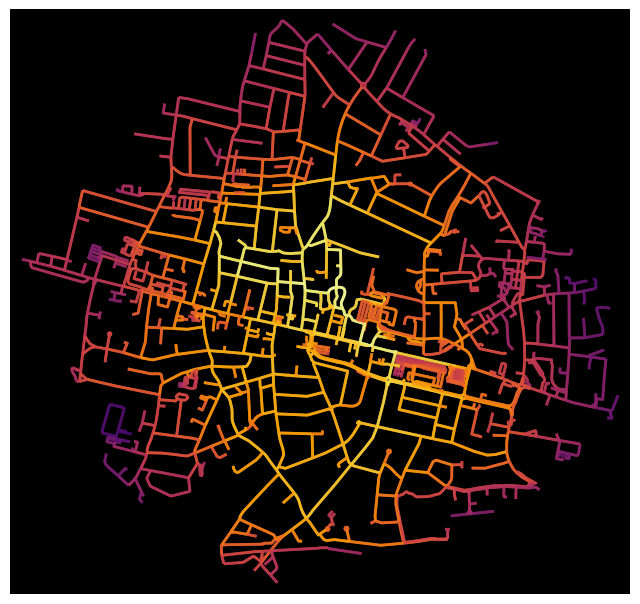

Processing borough: Enfield


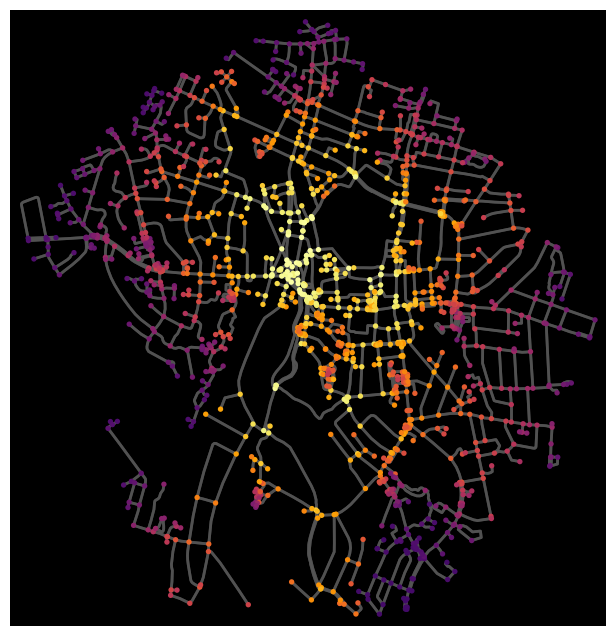

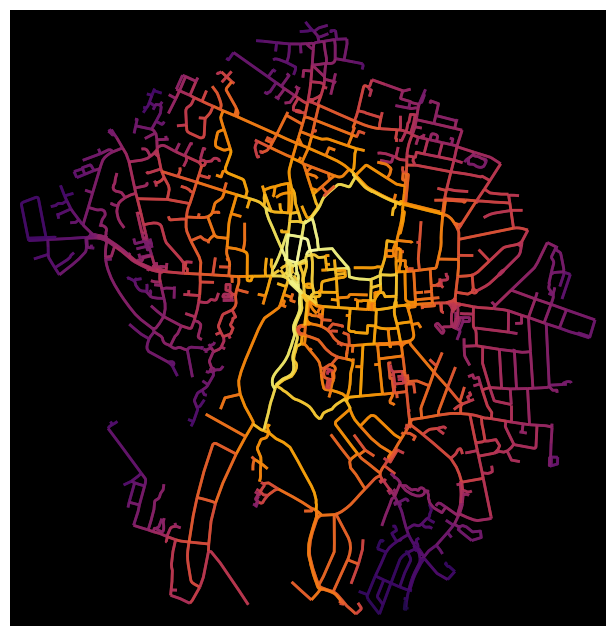

Processing borough: Waltham Forest


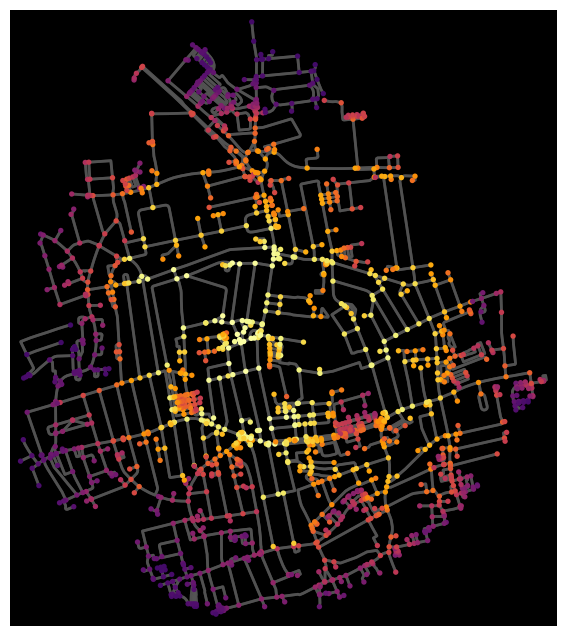

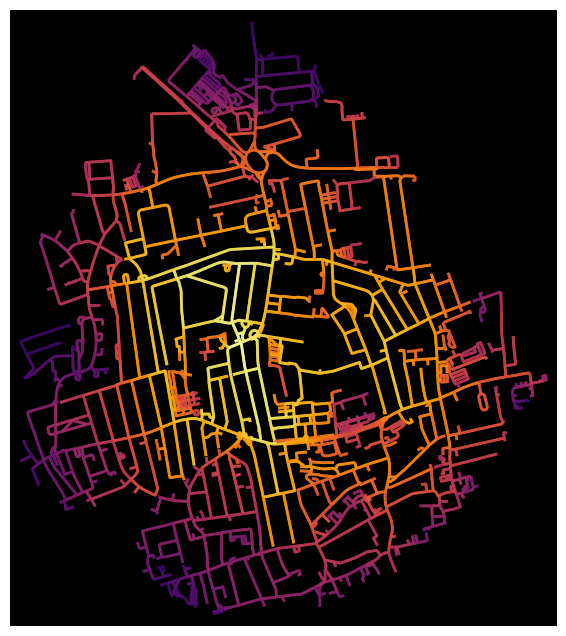

Processing borough: Redbridge


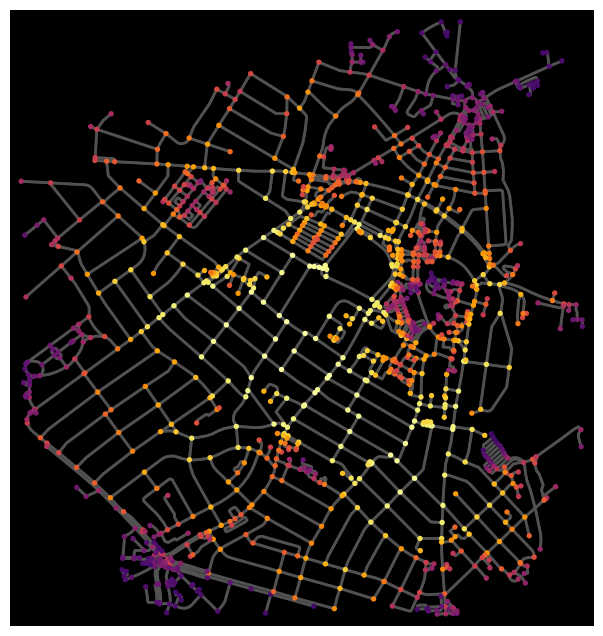

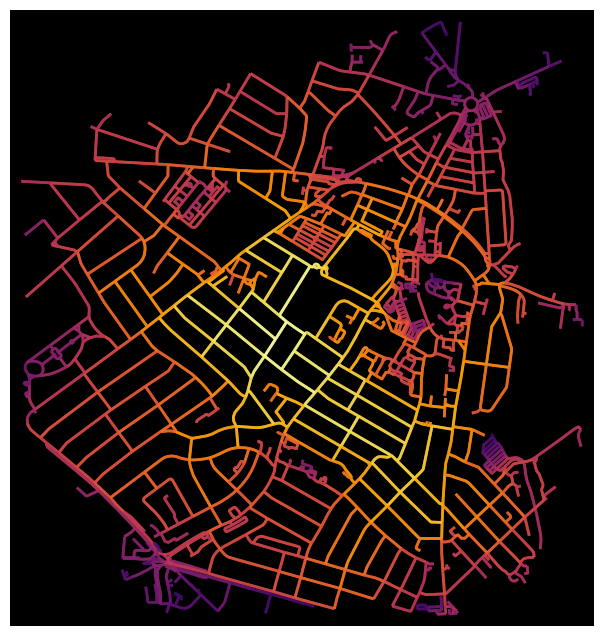

Processing borough: Sutton


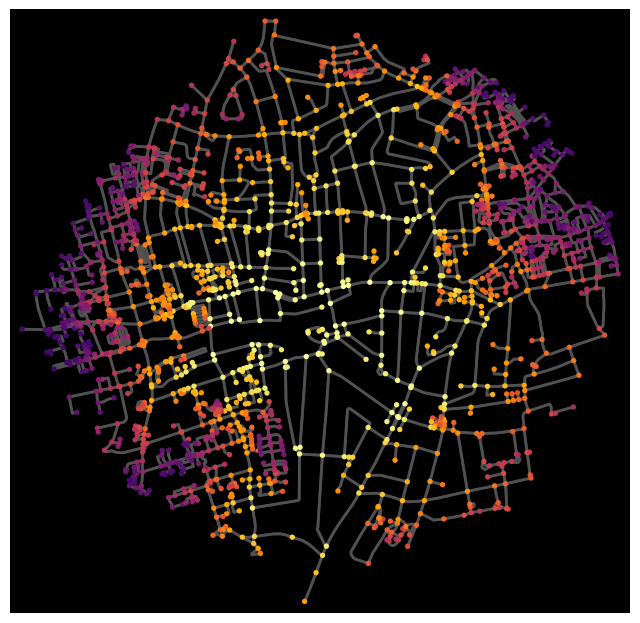

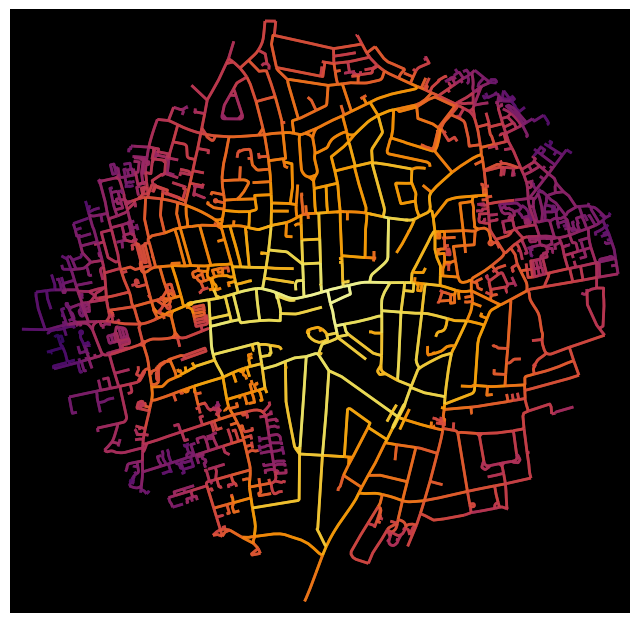

Processing borough: Richmond upon Thames


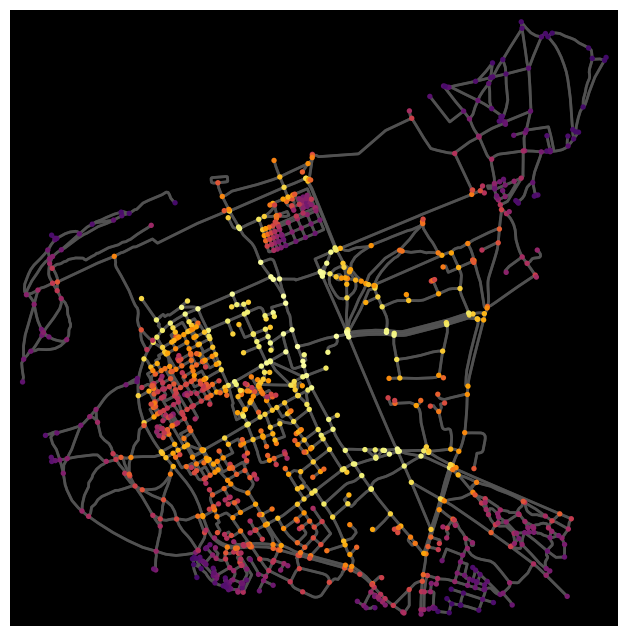

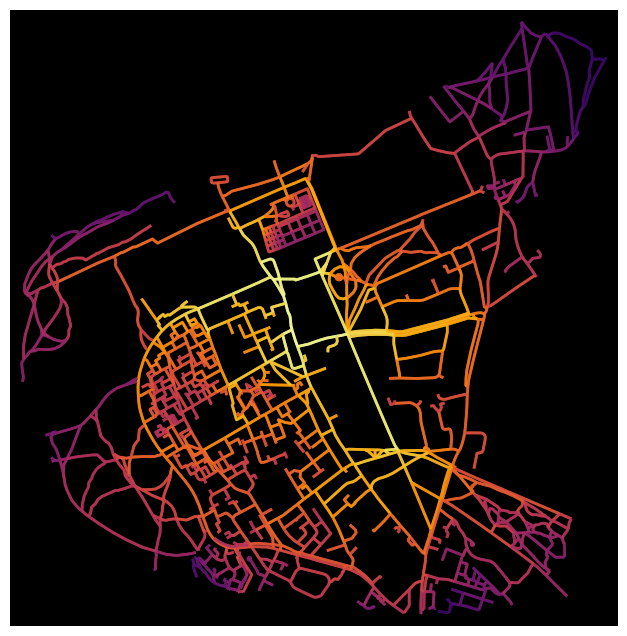

Processing borough: Merton


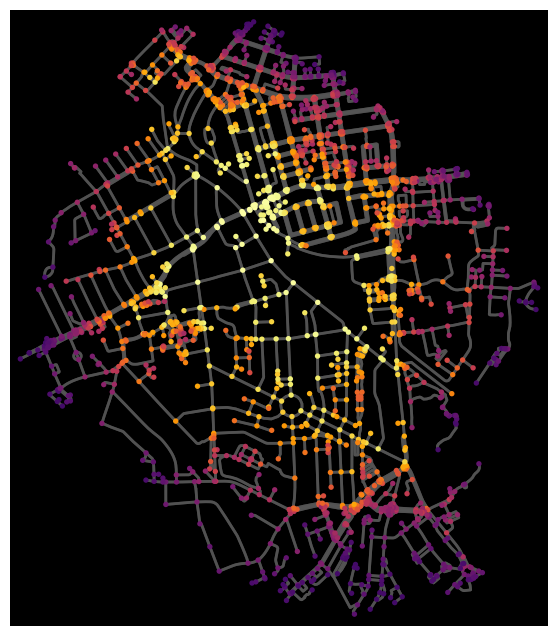

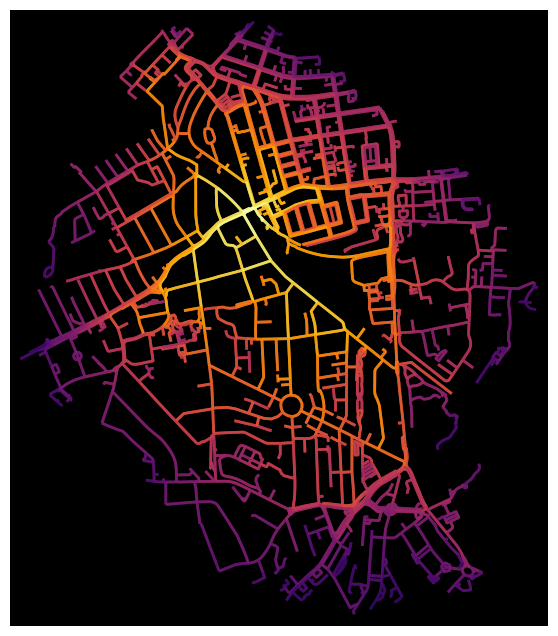

Processing borough: Wandsworth


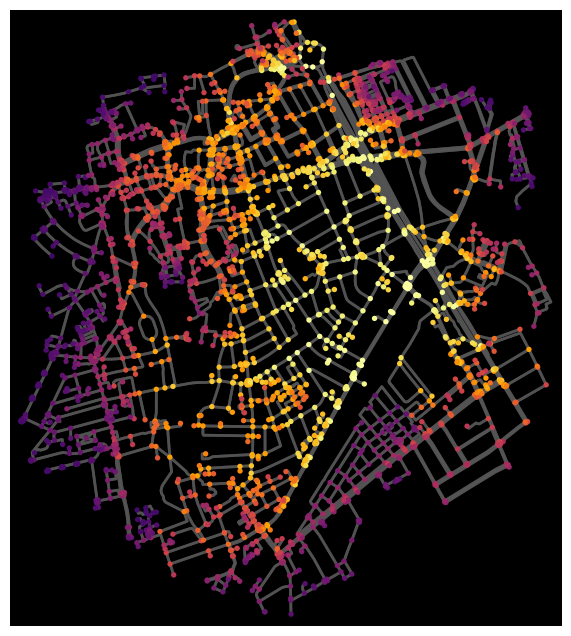

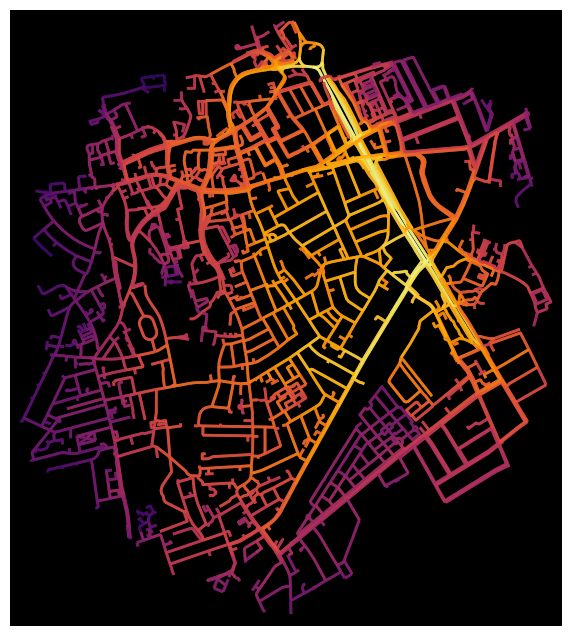

Processing borough: Hammersmith and Fulham


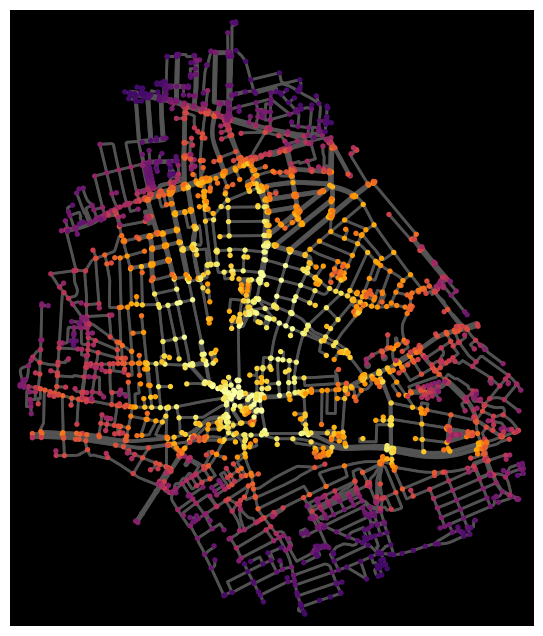

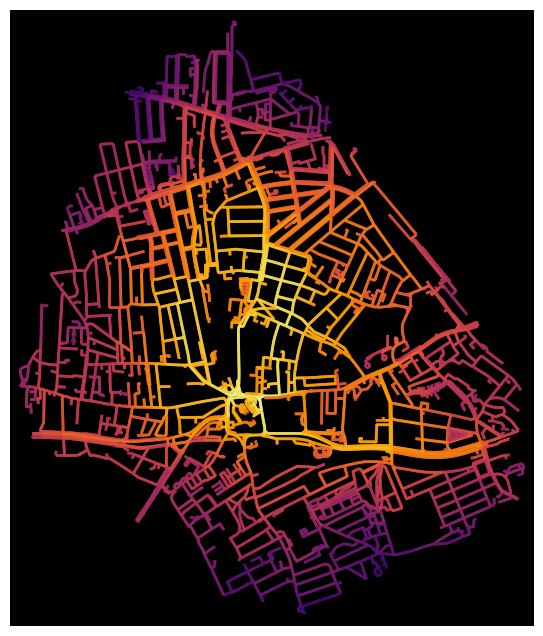

Processing borough: Kensington and Chelsea


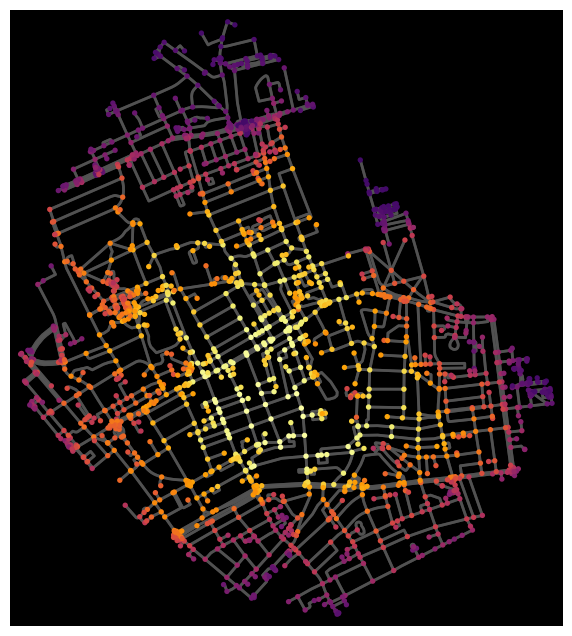

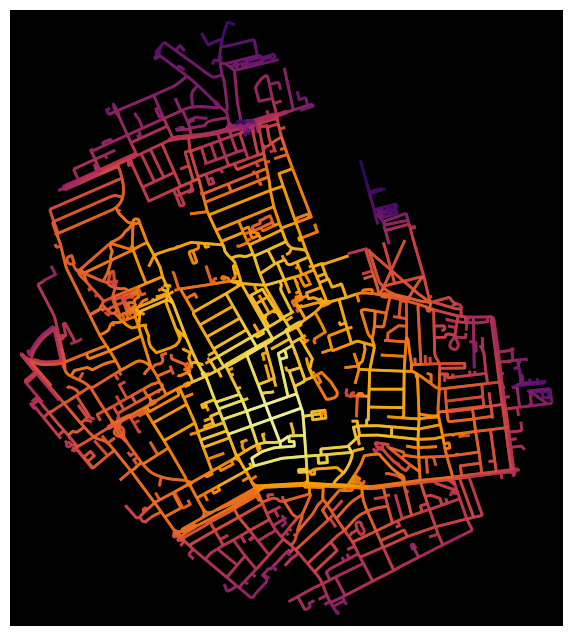

Processing borough: Westminster


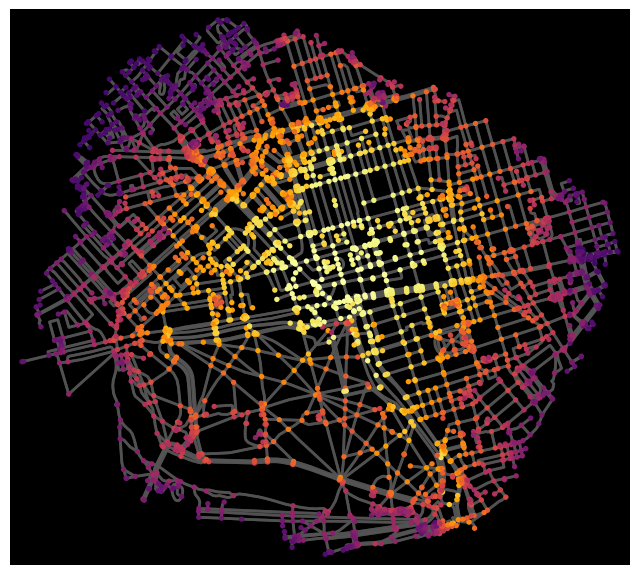

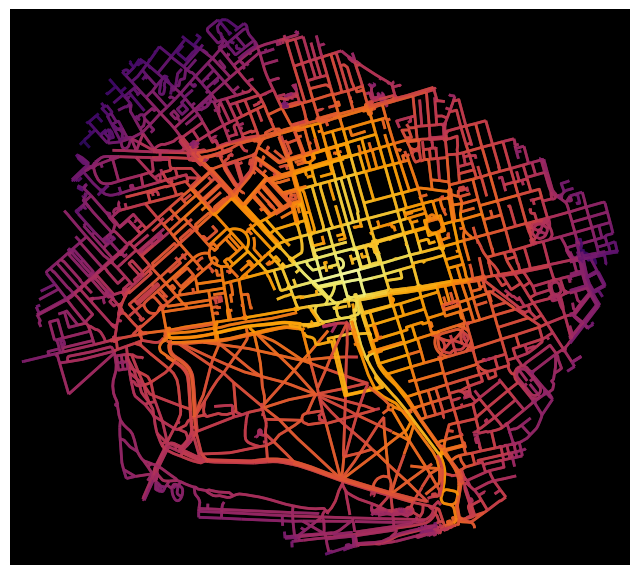

Processing borough: Camden


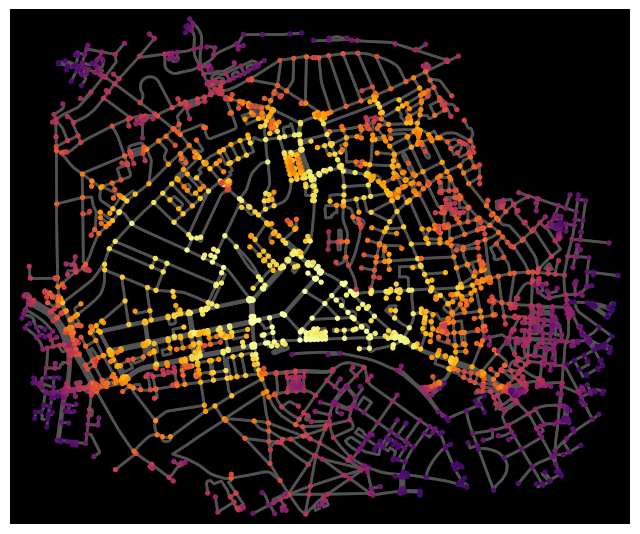

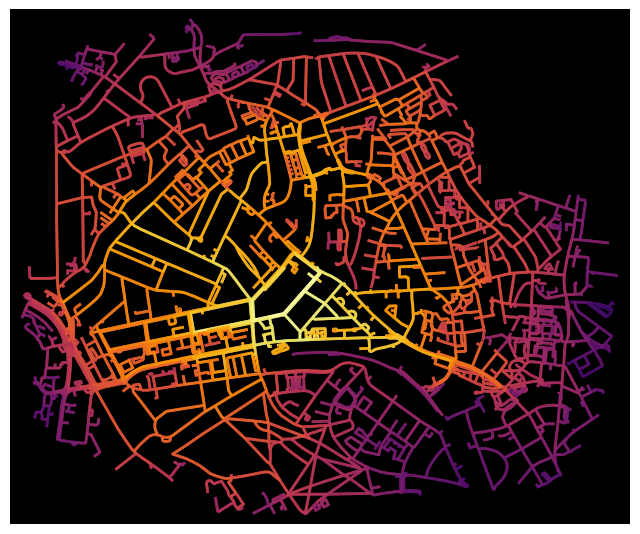

Processing borough: Tower Hamlets


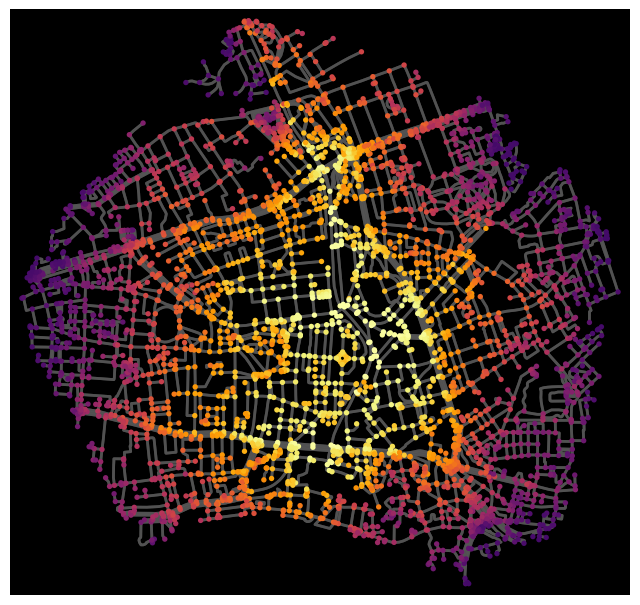

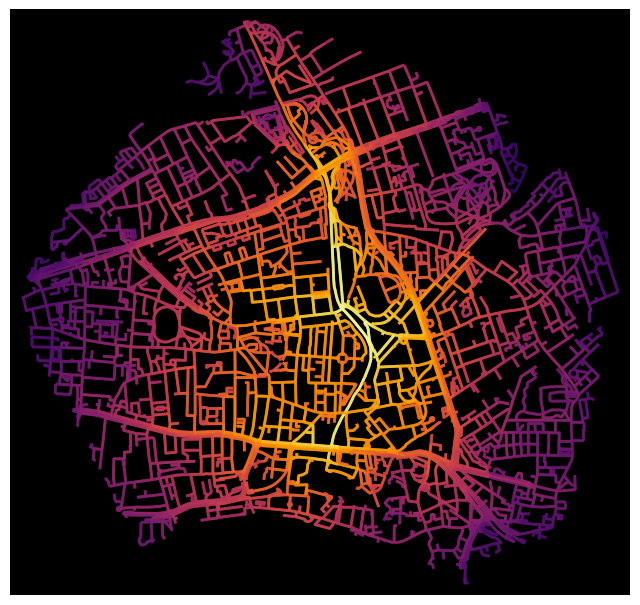

Processing borough: Islington


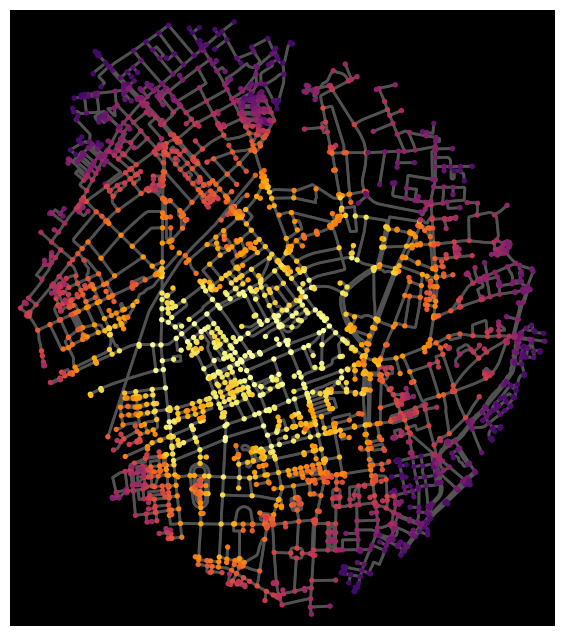

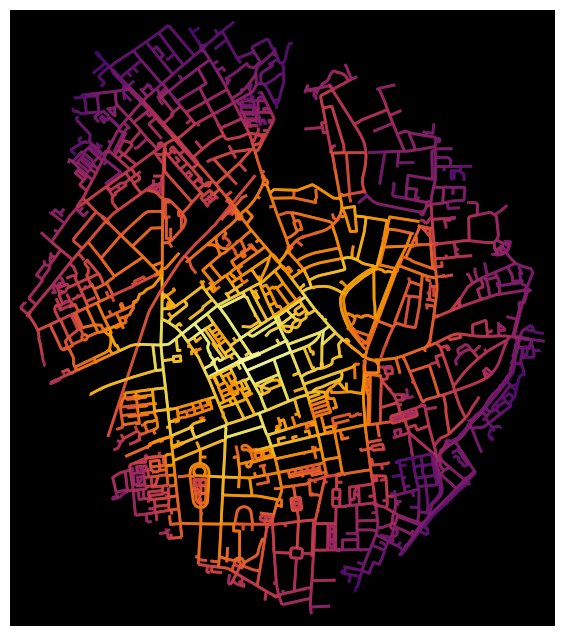

Processing borough: Hackney


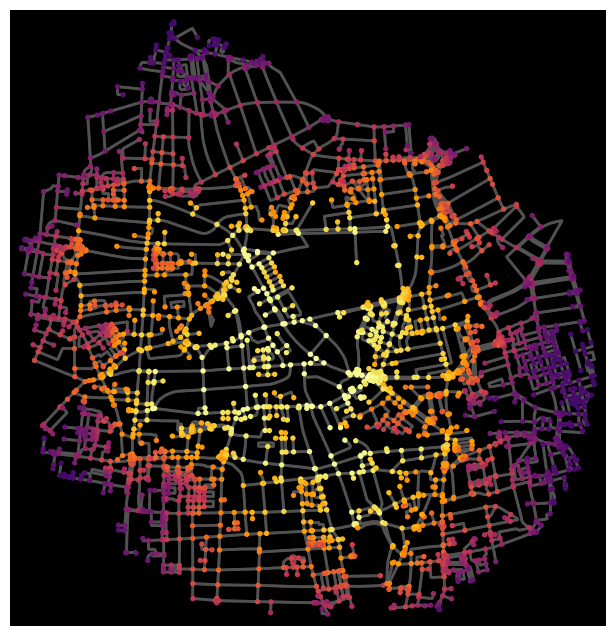

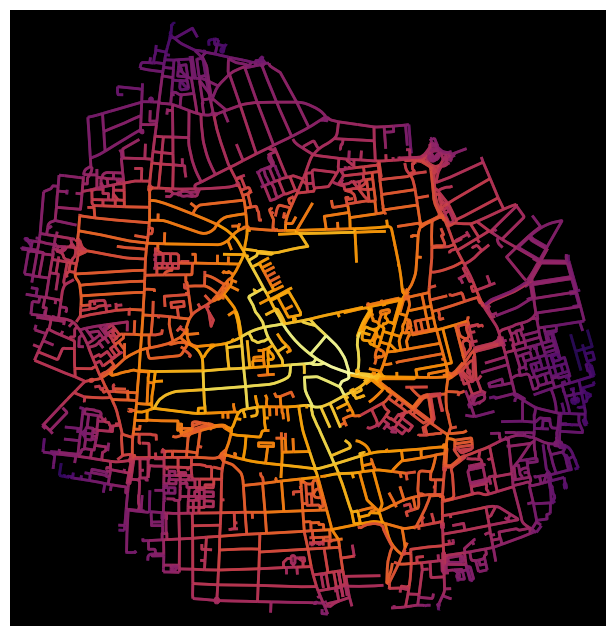

Processing borough: Haringey


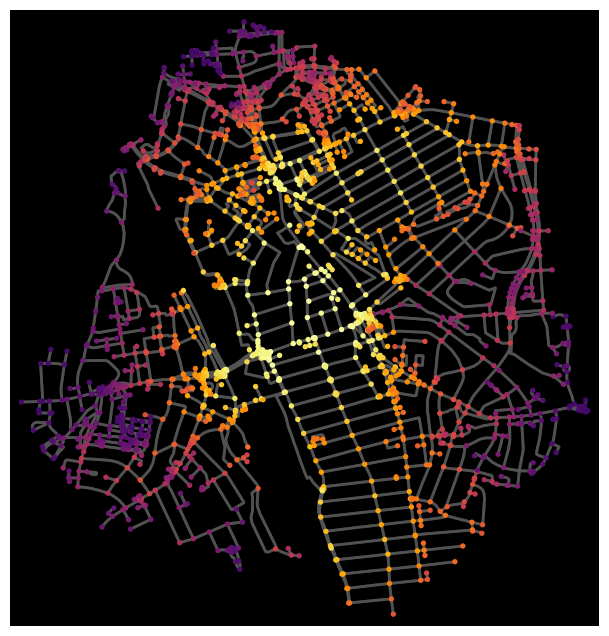

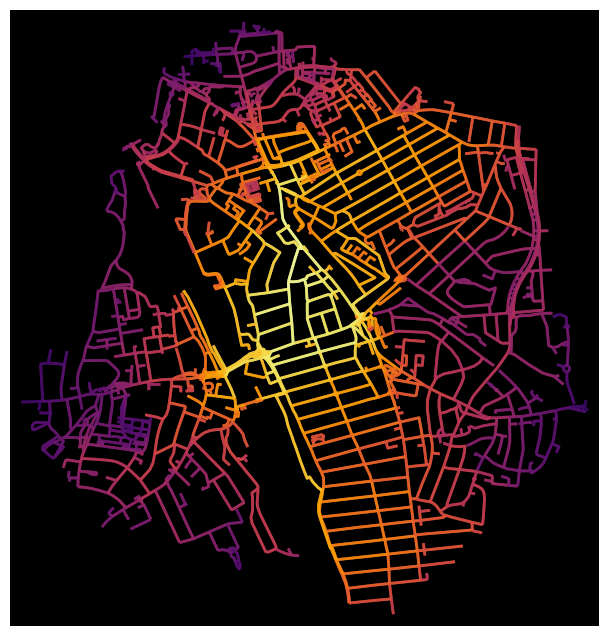

Processing borough: Newham


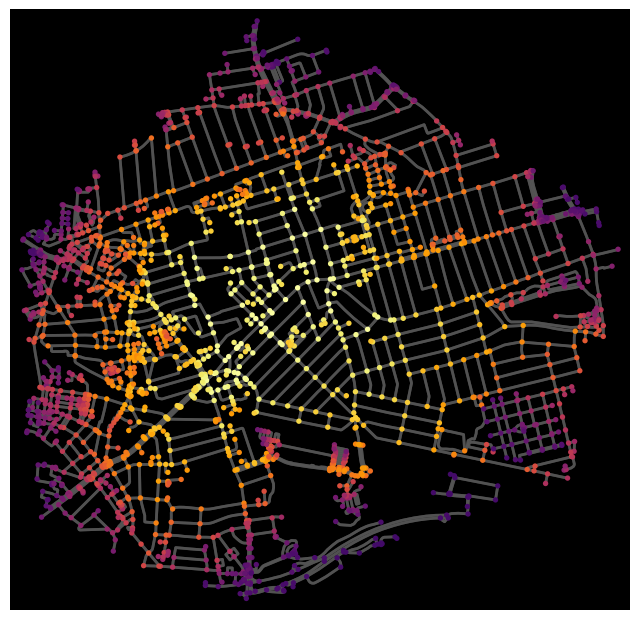

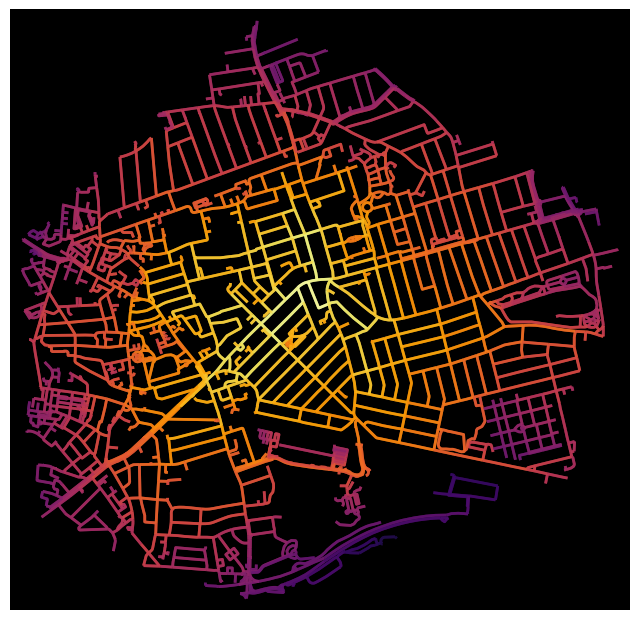

Processing borough: Barking and Dagenham


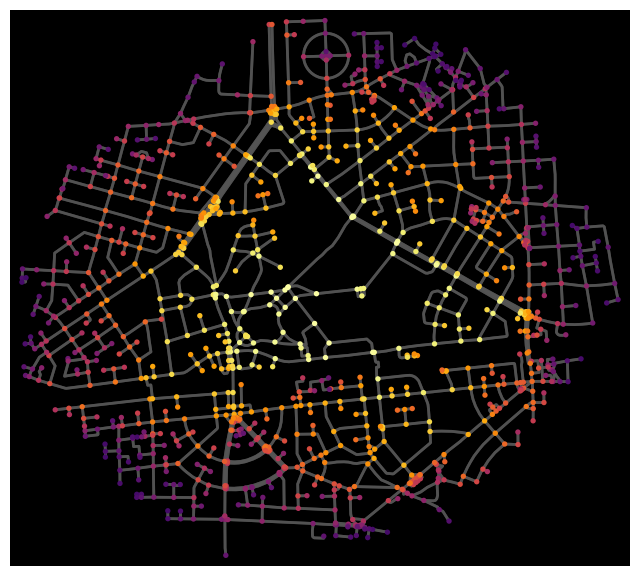

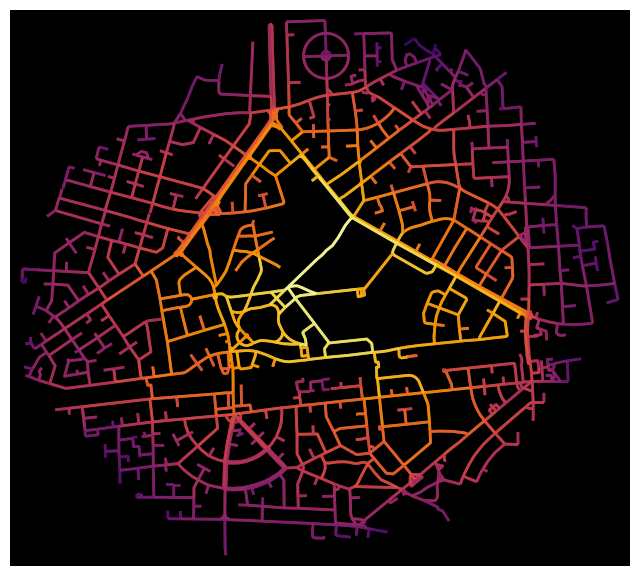

Processing borough: City of London


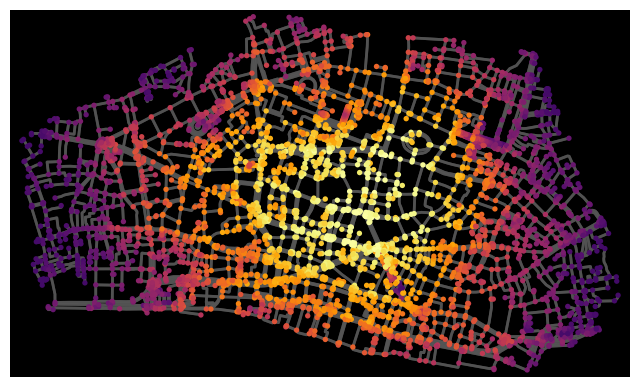

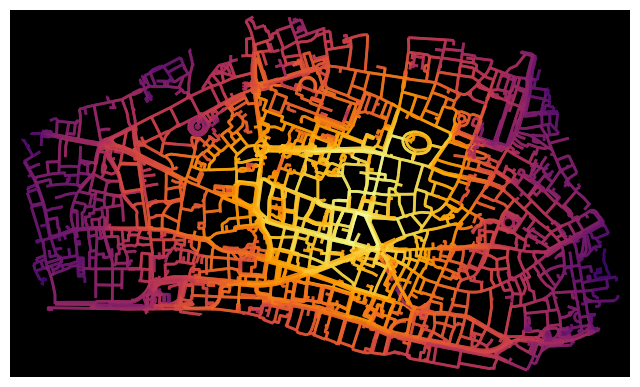

In [28]:
centrality_results = analyze_centrality_in_boroughs(walk_node_networks, walk_edge_networks)

In [29]:
# calculate the mean value in every borough
borough_centrality_averages = {}
for borough_name, centrality_data in centrality_results.items():
    node_centrality_values = list(centrality_data['node_closeness_centrality'].values())
    edge_centrality_values = list(centrality_data['edge_closeness_centrality'].values())
    
    borough_centrality_averages[borough_name] = {
        'node_closeness_centrality_avg': np.mean(node_centrality_values),
        'edge_closeness_centrality_avg': np.mean(edge_centrality_values)
    }

# add columns in borough_gdf_4326
borough_gdf_4326['node_centrality'] = borough_gdf_4326['NAME'].map(lambda x: borough_centrality_averages.get(x, {}).get('node_closeness_centrality_avg', np.nan))
borough_gdf_4326['edge_centrality'] = borough_gdf_4326['NAME'].map(lambda x: borough_centrality_averages.get(x, {}).get('edge_closeness_centrality_avg', np.nan))

In [30]:
borough_gdf_4326.head(3)

,NAME,GSS_CODE,HECTARES,NONLD_AREA,ONS_INNER,SUB_2009,SUB_2006,geometry,area_20min_walk,area,area_ratio,access_index,node_centrality,edge_centrality
0,Kingston upon Thames,E09000021,3726.117,0.0,F,None,None,"POLYGON ((-0.33066 51.32901, -0.33057 51.32909...",0.000633,0.004813,0.1316,0.63,0.045670,0.044912
1,Croydon,E09000008,8649.441,0.0,F,None,None,"POLYGON ((-0.06399 51.31864, -0.06405 51.31861...",0.000650,0.011164,0.0582,0.65,0.052922,0.051823
2,Bromley,E09000006,15013.487,0.0,F,None,None,"POLYGON ((0.01216 51.29960, 0.01199 51.29979, ...",0.000509,0.019384,0.0263,0.51,0.052531,0.050758


<h4>3. hospitals, schools - point pattern anaysis</h4>

In [31]:
borough_path = os.path.join('data', 'London_Borough', 'London_Borough_Excluding_MHW.shp')
borough_gdf = gpd.read_file(borough_path)
borough_gdf = borough_gdf.to_crs(epsg=4326)

In [32]:
# extract points of interest
def extract_points_from_place(query="London, United Kingdom", tags=None):
    results = ox.geometries_from_place(query, tags)
    points = results[results["amenity"].isin(tags.values())]["geometry"]
    return points


# organize the geometry
def polygon_to_centroid(geometry):
    if geometry.type == 'Polygon' or geometry.type == 'MultiPolygon':
        return geometry.centroid
    else:
        return geometry
    

# plot the points of interest
def plot_points(borough_gdf, amenity_gdf):
    fig, ax = plt.subplots(figsize=(10, 8))
    borough_gdf.plot(ax=ax, alpha=0.3, edgecolor='grey')
    amenity_gdf.plot(ax=ax, markersize=3, color='blue', figsize=(10, 8))
    plt.show()


# plot the quadrat map
def plot_quadrat_map(amenity_gdf, nx, ny):
    amenity_gdf = amenity_gdf.to_crs(epsg=27700)
    points = [Point(xy) for xy in amenity_gdf.geometry.values]
    point_array = np.array([[p.x, p.y] for p in points])
    pp_accident = PointPattern(point_array)
    q_r_accident = qs.QStatistic(pp_accident, shape="rectangle", nx=nx, ny=ny)
    print('Chi-squared test statistic for the observed point pattern is: '+ str(q_r_accident.chi2)) 
    print('Degree of freedom is: '+str(q_r_accident.df)) 
    print('P-values for Chi-squared test statistic is: '+str.format('{0:.6f}', q_r_accident.chi2_pvalue)) 
    q_r_accident.plot()
    plt.axis('off') # turn off the axis
    plt.show()


# generate the heatmap
def generate_heatmap(borough_gdf, data_gdf):
    # float type
    data_gdf['lat'] = data_gdf.geometry.y.astype(float)
    data_gdf['lon'] = data_gdf.geometry.x.astype(float)

    heat_df = data_gdf[['lat', 'lon']]
    heat_df = heat_df.dropna(axis=0, subset=['lat','lon'])

    # heat data
    heat_data = [[row['lat'],row['lon']] for index, row in heat_df.iterrows()]

    heatmap_map = folium.Map(location=[borough_gdf.geometry.centroid.y.mean(), borough_gdf.geometry.centroid.x.mean()], zoom_start=10)

    folium.GeoJson(borough_gdf, style_function=lambda feature: {
        'fillColor': 'none',
        'color': 'black',
        'weight': 2,
        'fillOpacity': 0
    }).add_to(heatmap_map)

    hm = plugins.HeatMap(heat_data)
    heatmap_map.add_child(hm)

    return heatmap_map


# KDE
def plot_kde(point_gdf, polygon_gdf, bandwidth, cmap='YlOrRd', title='Kernel Density Estimation'):
    point_gdf = point_gdf.to_crs(epsg=3857) # web mercator projection
    polygon_gdf = polygon_gdf.to_crs(epsg=3857)
    
    coords = np.array(list(point_gdf.geometry.apply(lambda x: [x.x, x.y])))
    
    # create a grid
    x_min, y_min, x_max, y_max = point_gdf.total_bounds
    x_grid, y_grid = np.mgrid[x_min:x_max:100j, y_min:y_max:100j]
    grid_points = np.vstack([x_grid.ravel(), y_grid.ravel()]).T
    
    # Gaussian KDE
    kde = KernelDensity(bandwidth=bandwidth, metric='euclidean', kernel='gaussian')
    kde.fit(coords)
    Z = np.exp(kde.score_samples(grid_points))
    Z = Z.reshape(x_grid.shape)
    
    # plot the KDE
    fig, ax = plt.subplots(figsize=(12, 12))
    im = ax.pcolormesh(x_grid, y_grid, Z, cmap=cmap, shading='auto')
    
    point_gdf.plot(ax=ax, markersize=10, color='black')
    polygon_gdf.boundary.plot(ax=ax, linewidth=0.5, color='black')
    
    ax.set_title(title, fontsize=24)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.get_xaxis().set_ticks([])
    ax.get_yaxis().set_ticks([])
    
    # add scale bar
    ax.annotate('N', xy=(0.1, 0.95), xycoords='axes fraction', fontsize=20, ha='center', va='center')
    
    # legend
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)
    cbar = fig.colorbar(im, cax=cax)
    cbar.ax.tick_params(labelsize=12)
    
    plt.tight_layout()
    plt.show()

School

In [33]:
school_tags = {"amenity": "school"}
school_gdf = gpd.GeoDataFrame(extract_points_from_place(tags=school_tags))
school_gdf['geometry'] = school_gdf['geometry'].apply(polygon_to_centroid)

d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)
C:\Users\kayla\AppData\Local\Temp\ipykernel_27972\2586639428.py:10: ShapelyDeprecationWarning: The 'type' attribute is deprecated, and will be removed in the future. You can use the 'geom_type' attribute instead.
  if geometry.type == 'Polygon' or geometry.type == 'MultiPolygon':


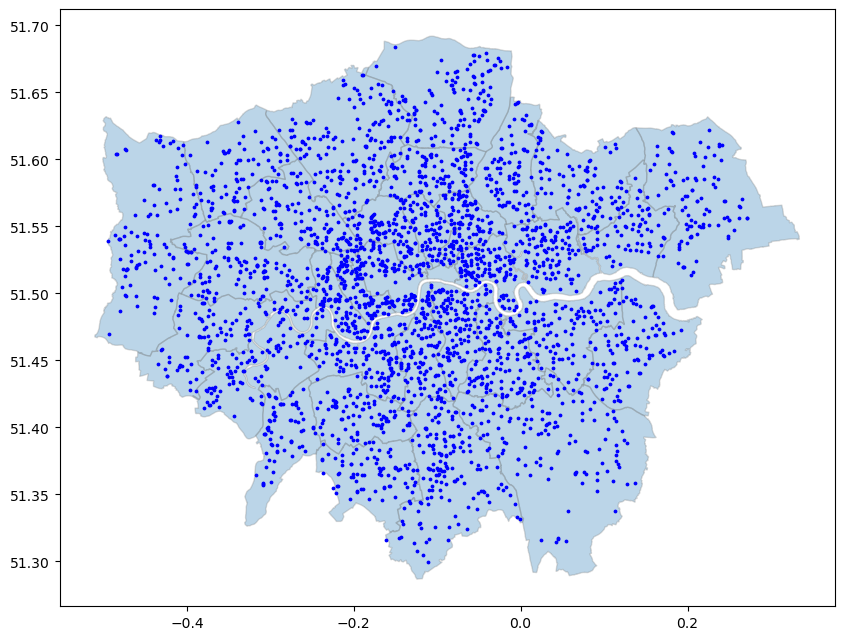

In [34]:
plot_points(borough_gdf, school_gdf)

Chi-squared test statistic for the observed point pattern is: 2384.6698432216417
Degree of freedom is: 19
P-values for Chi-squared test statistic is: 0.000000


d:\Anaconda\envs\mscui2023\lib\site-packages\libpysal\cg\shapes.py:1492: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)
d:\Anaconda\envs\mscui2023\lib\site-packages\libpysal\cg\shapes.py:1208: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)


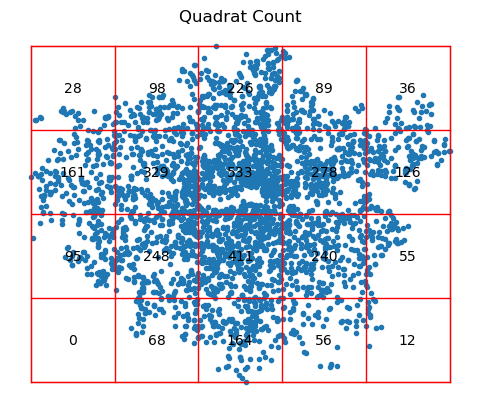

In [35]:
plot_quadrat_map(school_gdf, 5, 4)

In [36]:
heat_map = generate_heatmap(borough_gdf, school_gdf)
heat_map.save('pic/heatmap_school.html')
heat_map

C:\Users\kayla\AppData\Local\Temp\ipykernel_27972\2586639428.py:51: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  heatmap_map = folium.Map(location=[borough_gdf.geometry.centroid.y.mean(), borough_gdf.geometry.centroid.x.mean()], zoom_start=10)


d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)


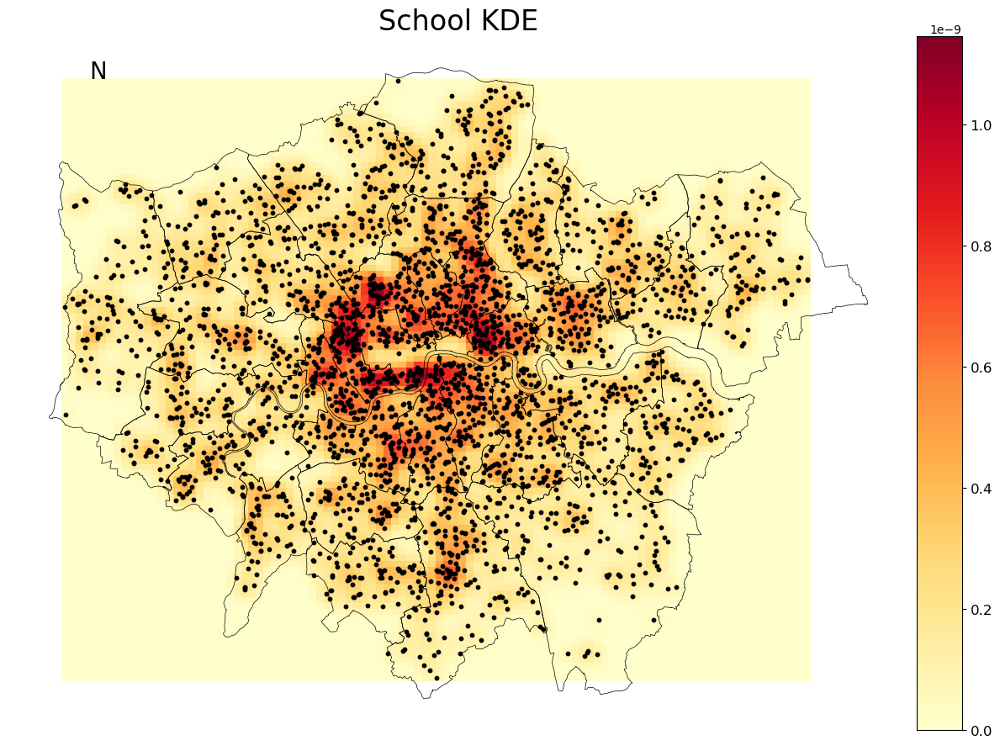

In [37]:
plot_kde(school_gdf, borough_gdf, bandwidth=1000, title='School KDE')

Hospital

In [38]:
hospital_tags = {"amenity": "hospital"}
hospital_gdf = gpd.GeoDataFrame(extract_points_from_place(tags=hospital_tags))
hospital_gdf['geometry'] = hospital_gdf['geometry'].apply(polygon_to_centroid)

C:\Users\kayla\AppData\Local\Temp\ipykernel_27972\2586639428.py:3: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.
  results = ox.geometries_from_place(query, tags)


d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)
C:\Users\kayla\AppData\Local\Temp\ipykernel_27972\2586639428.py:10: ShapelyDeprecationWarning: The 'type' attribute is deprecated, and will be removed in the future. You can use the 'geom_type' attribute instead.
  if geometry.type == 'Polygon' or geometry.type == 'MultiPolygon':


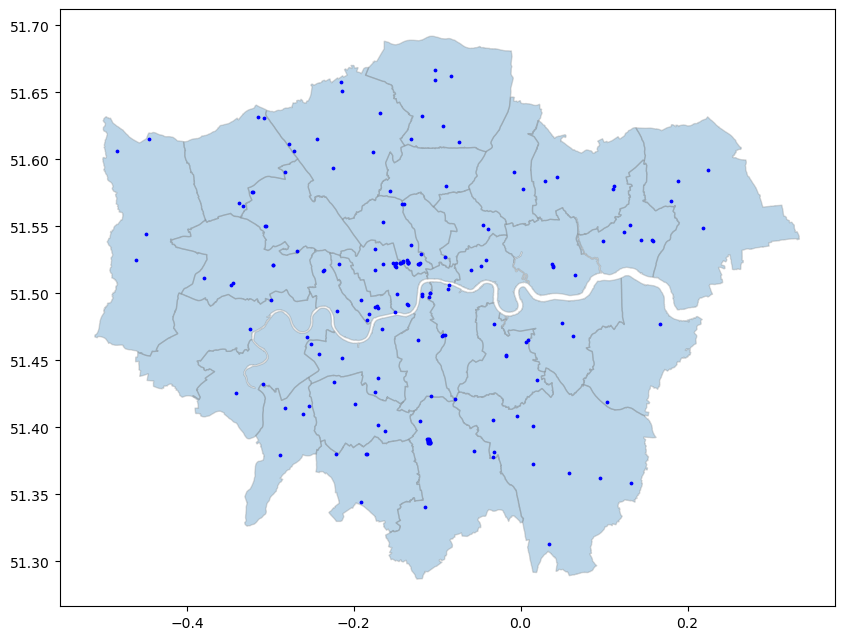

In [39]:
plot_points(borough_gdf, hospital_gdf)

Chi-squared test statistic for the observed point pattern is: 199.9130434782609
Degree of freedom is: 19
P-values for Chi-squared test statistic is: 0.000000


d:\Anaconda\envs\mscui2023\lib\site-packages\libpysal\cg\shapes.py:1492: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)
d:\Anaconda\envs\mscui2023\lib\site-packages\libpysal\cg\shapes.py:1208: FutureWarning: Objects based on the `Geometry` class will deprecated and removed in a future version of libpysal.
  warnings.warn(dep_msg, FutureWarning)


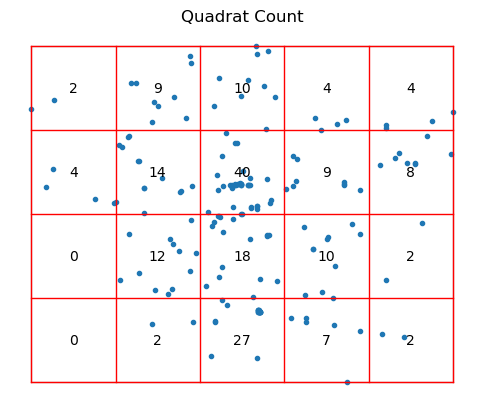

In [40]:
plot_quadrat_map(hospital_gdf, 5, 4)

In [41]:
heat_map = generate_heatmap(borough_gdf, hospital_gdf)
heat_map.save('pic/heatmap_hospital.html')
heat_map

C:\Users\kayla\AppData\Local\Temp\ipykernel_27972\2586639428.py:51: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  heatmap_map = folium.Map(location=[borough_gdf.geometry.centroid.y.mean(), borough_gdf.geometry.centroid.x.mean()], zoom_start=10)


d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)


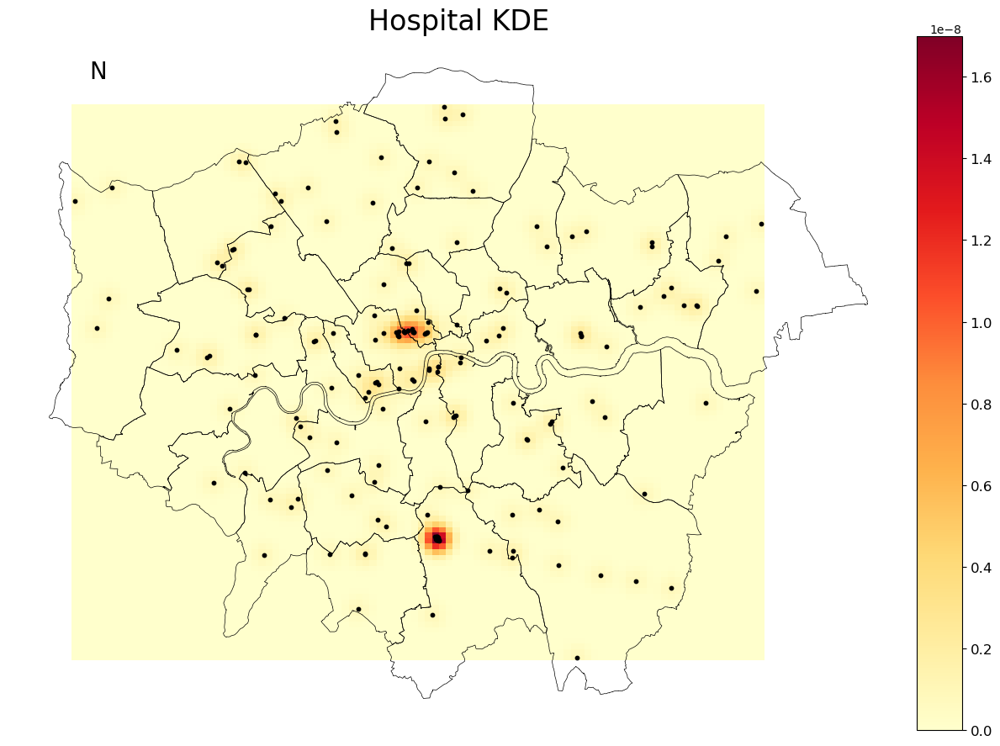

In [42]:
plot_kde(hospital_gdf, borough_gdf, bandwidth=1000, title='Hospital KDE')

Variables for spatial regression

In [43]:
def calculate_point_count(borough_gdf, amenity_gdf):
    point_count = []
    for index, row in borough_gdf.iterrows():
        borough_geometry = row['geometry']
        points_in_borough = amenity_gdf[amenity_gdf.geometry.within(borough_geometry)]
        point_count.append(len(points_in_borough))
    return pd.Series(point_count, index=borough_gdf.index)

In [44]:
borough_gdf_4326['school_count'] = calculate_point_count(borough_gdf, school_gdf)
borough_gdf_4326['hospital_count'] = calculate_point_count(borough_gdf, hospital_gdf)

# calculate the density
borough_gdf_4326['area'] = borough_gdf.to_crs(epsg=27700)['geometry'].area / 10**6
borough_gdf_4326['school_density'] = borough_gdf_4326['school_count'] / borough_gdf_4326['area']
borough_gdf_4326['hospital_density'] = borough_gdf_4326['hospital_count'] / borough_gdf_4326['area']

In [45]:
weights_of_index = {
    'IMD2019_In': 0.225,
    'IMD2019_Em': 0.225,
    'IMD2019_Ed': 0.135,
    'IMD2019_He': 0.135,
    'IMD2019_Cr': 0.093,
    'IMD2019_Li': 0.093,
    'IMD2019_Ba': 0.093
}

# calculate IMD_score
lsoa_gdf['IMD_score'] = sum(lsoa_gdf[col] * weights_of_index[col] for col in weights_of_index.keys())
lsoa_gdf.head(3)

,LSOA11CD,LSOA11NM,MSOA11CD,MSOA11NM,LAD11CD,LAD11NM,RGN11CD,RGN11NM,USUALRES,HHOLDRES,...,IMD2019_14,IMD2019_15,IMD2019_Ba,IMD2019_16,IMD2019_17,IMD2019_Li,IMD2019_18,IMD2019_19,geometry,IMD_score
0,E01000001,City of London 001A,E02000001,City of London 001,E09000001,City of London,E12000007,London,1465,1465,...,32662,10,29.5,7319,3,31.9,7789,3,"POLYGON ((532105.092 182011.230, 532162.491 18...",6.6897
1,E01000002,City of London 001B,E02000001,City of London 001,E09000001,City of London,E12000007,London,1436,1436,...,32789,10,24.4,11707,4,23.1,13070,4,"POLYGON ((532746.813 181786.891, 532671.688 18...",5.2161
2,E01000003,City of London 001C,E02000001,City of London 001,E09000001,City of London,E12000007,London,1346,1250,...,29363,9,40.1,2157,1,40.5,4092,2,"POLYGON ((532135.145 182198.119, 532158.250 18...",12.5598


In [46]:
imd_mean = lsoa_gdf.groupby('LAD11CD')['IMD_score'].mean()

borough_gdf_4326['IMD_score'] = borough_gdf_4326['GSS_CODE'].map(imd_mean)
borough_gdf_4326['IMD_score'] = round(borough_gdf_4326['IMD_score'], 2)
borough_gdf_4326.head(3)

,NAME,GSS_CODE,HECTARES,NONLD_AREA,ONS_INNER,SUB_2009,SUB_2006,geometry,area_20min_walk,area,area_ratio,access_index,node_centrality,edge_centrality,school_count,hospital_count,school_density,hospital_density,IMD_score
0,Kingston upon Thames,E09000021,3726.117,0.0,F,None,None,"POLYGON ((-0.33066 51.32901, -0.33057 51.32909...",0.000633,37.261178,0.1316,0.63,0.045670,0.044912,70,4,1.878631,0.107350,7.88
1,Croydon,E09000008,8649.441,0.0,F,None,None,"POLYGON ((-0.06399 51.31864, -0.06405 51.31861...",0.000650,86.494436,0.0582,0.65,0.052922,0.051823,155,24,1.792023,0.277474,12.51
2,Bromley,E09000006,15013.487,0.0,F,None,None,"POLYGON ((0.01216 51.29960, 0.01199 51.29979, ...",0.000509,150.134858,0.0263,0.51,0.052531,0.050758,120,10,0.799281,0.066607,8.71


In [47]:
desired_columns = ['NAME', 'IMD_score', 'access_index', 'node_centrality', 'edge_centrality',  'school_density', 'hospital_density', 'geometry']
reg_gdf = borough_gdf_4326[desired_columns].copy()
reg_gdf = reg_gdf.set_geometry('geometry')
reg_gdf = reg_gdf.to_crs(epsg=4326)

In [48]:
reg_gdf.head(3)

,NAME,IMD_score,access_index,node_centrality,edge_centrality,school_density,hospital_density,geometry
0,Kingston upon Thames,7.88,0.63,0.045670,0.044912,1.878631,0.107350,"POLYGON ((-0.33066 51.32901, -0.33057 51.32909..."
1,Croydon,12.51,0.65,0.052922,0.051823,1.792023,0.277474,"POLYGON ((-0.06399 51.31864, -0.06405 51.31861..."
2,Bromley,8.71,0.51,0.052531,0.050758,0.799281,0.066607,"POLYGON ((0.01216 51.29960, 0.01199 51.29979, ..."


In [49]:
reg_gdf['node_centrality'] = round(reg_gdf['node_centrality'], 4)
reg_gdf['edge_centrality'] = round(reg_gdf['edge_centrality'], 4)
reg_gdf['school_density'] = round(reg_gdf['school_density'], 4)
reg_gdf['hospital_density'] = round(reg_gdf['hospital_density'], 4)

In [50]:
reg_gdf.isnull().sum()

NAME                0
IMD_score           0
access_index        0
node_centrality     0
edge_centrality     0
school_density      0
hospital_density    0
geometry            0
dtype: int64

In [51]:
# save the data
reg_gdf.to_file('data/regression_data.shp')

C:\Users\kayla\AppData\Local\Temp\ipykernel_27972\940472413.py:2: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  reg_gdf.to_file('data/regression_data.shp')


In [52]:
# Choropleth map for variables
def plot_choropleth(gdf, column, cmap='coolwarm', title='Choropleth Map'):
    gdf = gdf.to_crs(epsg=3857)  # Web Mercator
    
    fig, ax = plt.subplots(figsize=(10, 10))
    
    gdf.plot(column=column, cmap=cmap, scheme='quantiles', alpha=0.8, legend=True, ax=ax)
    gdf.boundary.plot(ax=ax, edgecolor='gray', linewidth=0.5)
    ax.set_axis_off()
    ax.set_title(title, fontsize=24)
    
    ax.annotate('N', xy=(0.1, 0.9), xycoords='axes fraction', fontsize=20, ha='center', va='center')
    
    legend = ax.get_legend()
    legend.set_bbox_to_anchor((0.95, 0.25))
    legend._legend_box.align = "left"
    
    plt.tight_layout()
    plt.show()

d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


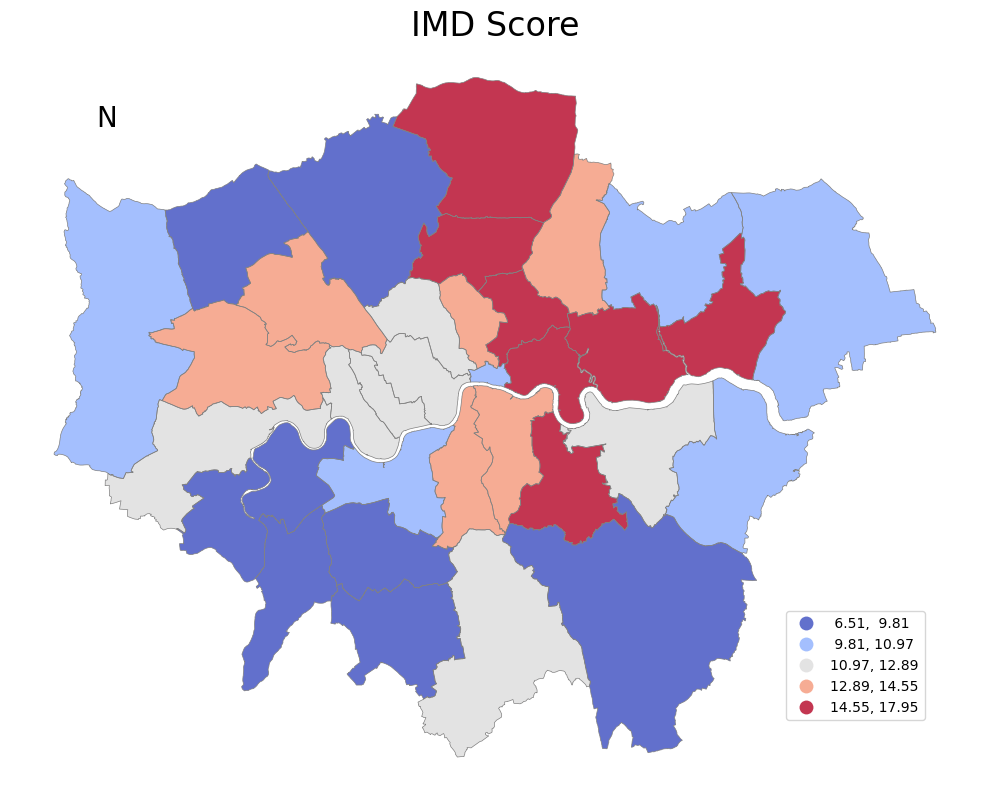

d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


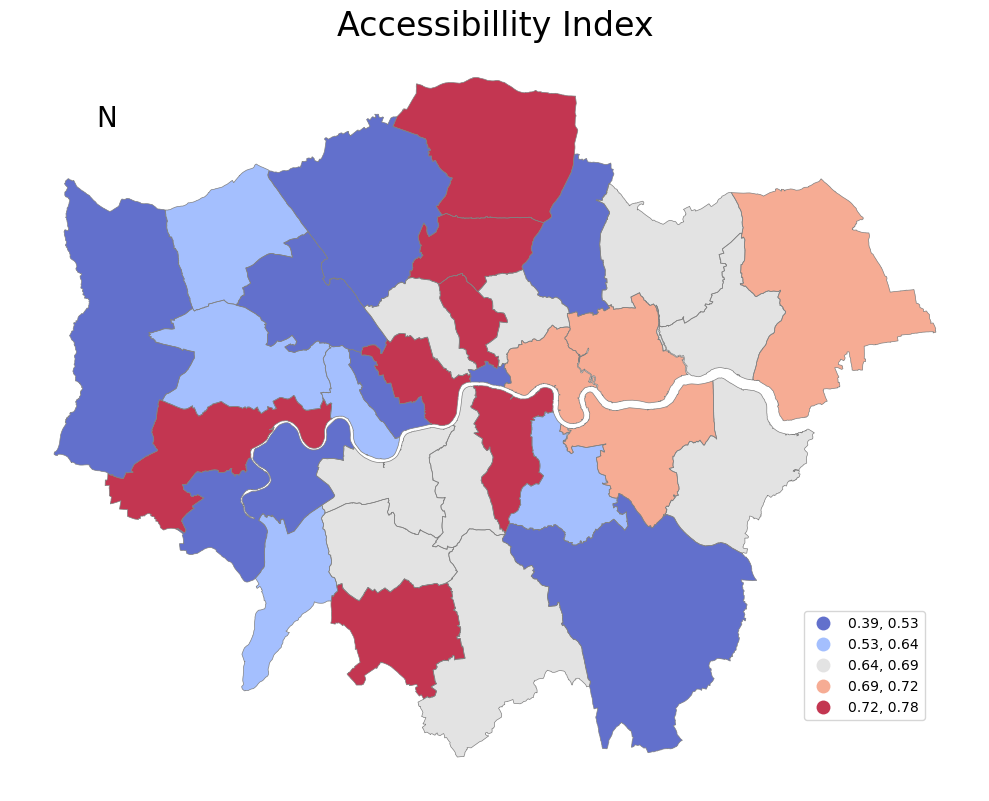

d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


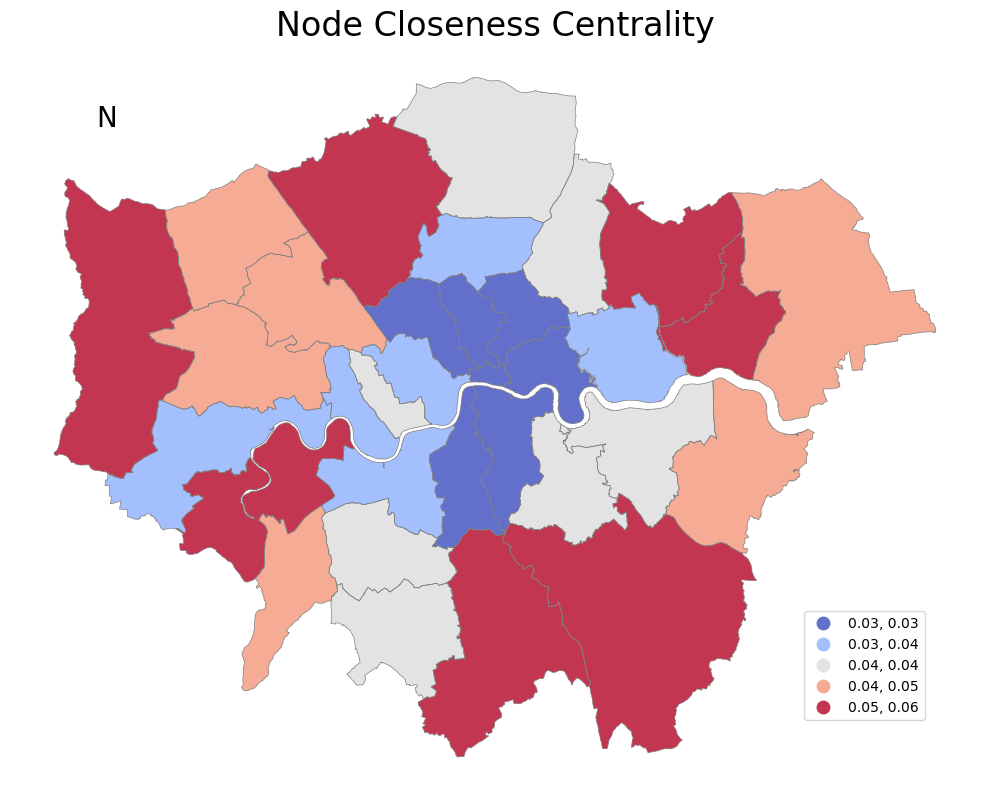

d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


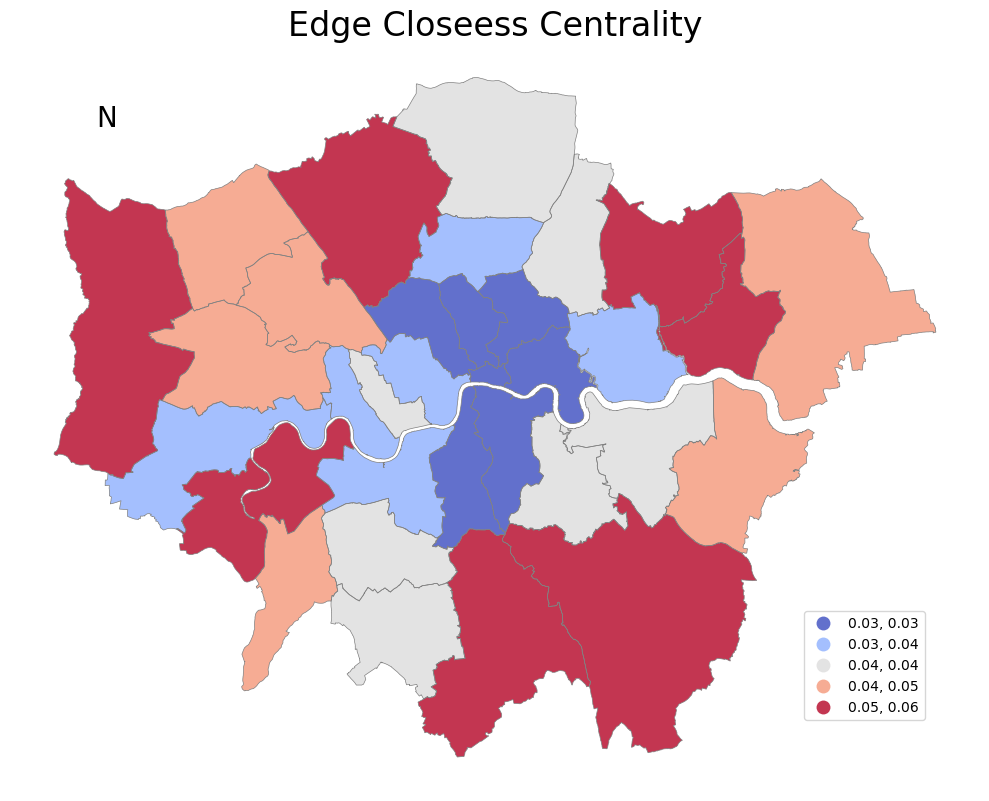

d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


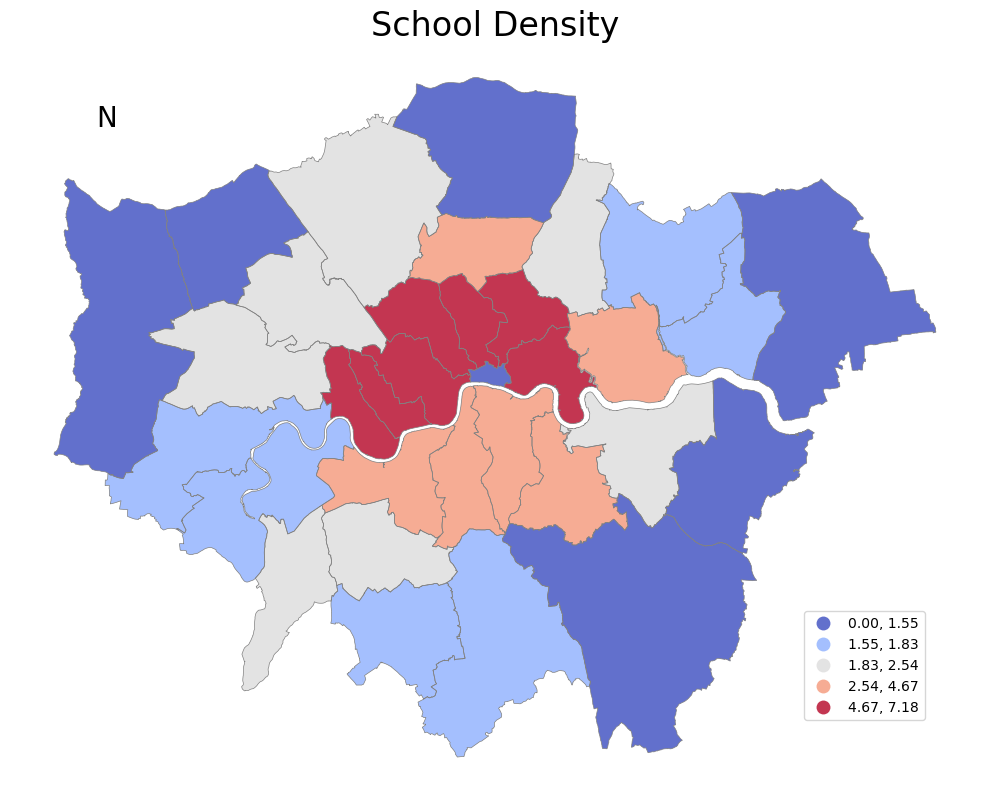

d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


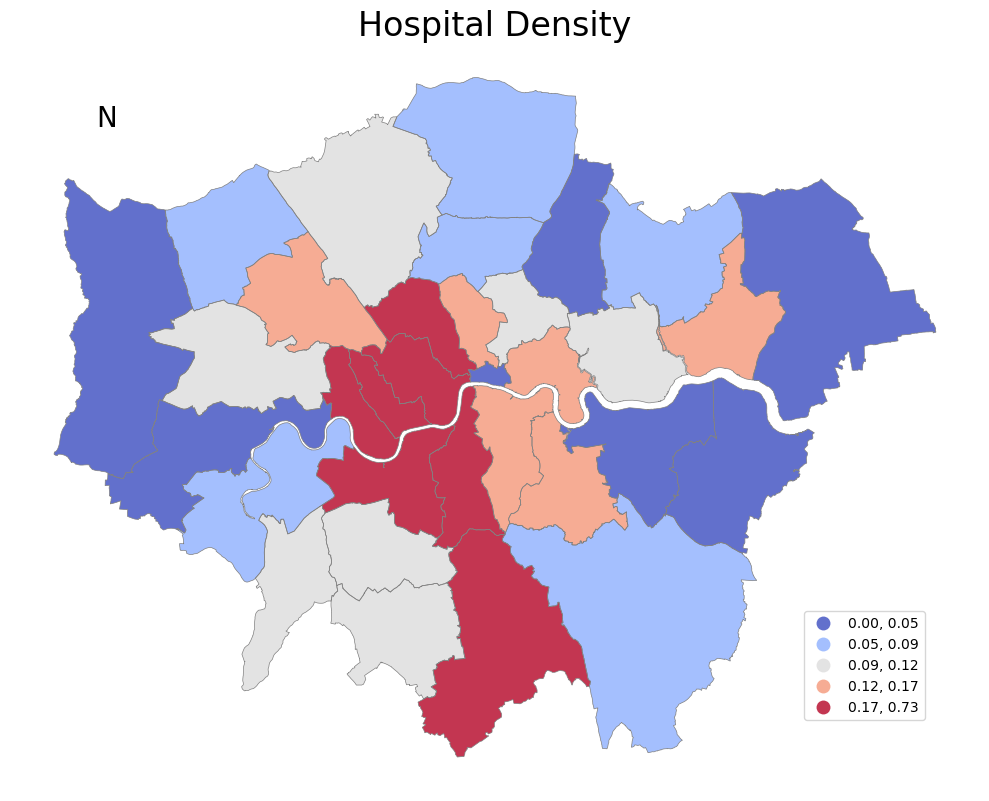

In [53]:
plot_choropleth(reg_gdf, 'IMD_score', title= 'IMD Score')
plot_choropleth(reg_gdf, 'access_index', title= 'Accessibillity Index')

plot_choropleth(reg_gdf, 'node_centrality', title= 'Node Closeness Centrality')
plot_choropleth(reg_gdf, 'edge_centrality', title= 'Edge Closeess Centrality')

plot_choropleth(reg_gdf, 'school_density', title= 'School Density')
plot_choropleth(reg_gdf, 'hospital_density', title= 'Hospital Density')

<h4>4. The realationship between the IMD and the accessibility, network centrality, density of amenities (hospitals, schools) - Spatial Regression</h4>

In [54]:
df = reg_gdf.drop(columns=['geometry', 'NAME'])
correlation_matrix = df.corr()
correlation_matrix

,IMD_score,access_index,node_centrality,edge_centrality,school_density,hospital_density
IMD_score,1.000000,0.287390,-0.352627,-0.344786,0.390886,0.075368
access_index,0.287390,1.000000,-0.419036,-0.408753,0.240593,0.134440
node_centrality,-0.352627,-0.419036,1.000000,0.999338,-0.623918,-0.314110
edge_centrality,-0.344786,-0.408753,0.999338,1.000000,-0.630509,-0.313029
school_density,0.390886,0.240593,-0.623918,-0.630509,1.000000,0.661776
hospital_density,0.075368,0.134440,-0.314110,-0.313029,0.661776,1.000000


In [55]:
reg_gdf = reg_gdf.drop(columns=['edge_centrality'])
reg_gdf.head(3)

,NAME,IMD_score,access_index,node_centrality,school_density,hospital_density,geometry
0,Kingston upon Thames,7.88,0.63,0.0457,1.8786,0.1074,"POLYGON ((-0.33066 51.32901, -0.33057 51.32909..."
1,Croydon,12.51,0.65,0.0529,1.7920,0.2775,"POLYGON ((-0.06399 51.31864, -0.06405 51.31861..."
2,Bromley,8.71,0.51,0.0525,0.7993,0.0666,"POLYGON ((0.01216 51.29960, 0.01199 51.29979, ..."


In [56]:
y = np.array(reg_gdf['IMD_score'])
y.shape = (len(y), 1)

X = []
X.append(reg_gdf['access_index'])
X.append(reg_gdf['node_centrality'])
X.append(reg_gdf['school_density'])
X.append(reg_gdf['hospital_density'])

X = np.array(X).T

In [57]:
# Moran's I of reg_gdf
w_queen = weights.Queen.from_dataframe(reg_gdf)
mi = esda.Moran(y, w_queen)

print("The Statistic Moran's I is: " + str("%.4f" % mi.I),
      "\nThe Expected Value for Statistic I is: " + str("%.4f" % mi.EI),
      "\nThe Significance Test Value is: " + str("%.4f" % mi.p_norm))

The Statistic Moran's I is: 0.2883 
The Expected Value for Statistic I is: -0.0312 
The Significance Test Value is: 0.0060


C:\Users\kayla\AppData\Local\Temp\ipykernel_27972\3336535235.py:2: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w_queen = weights.Queen.from_dataframe(reg_gdf)


In [58]:
ols_model = OLS(y, X, name_y = 'IMD_score', 
               name_x = ['access index', 'node centrality', 'school density', 'hospital density'],
               name_ds = 'reg_gdf')
print(ols_model.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     reg_gdf
Weights matrix      :        None
Dependent Variable  :   IMD_score                Number of Observations:          33
Mean dependent var  :     12.1603                Number of Variables   :           5
S.D. dependent var  :      2.7613                Degrees of Freedom    :          28
R-squared           :      0.2502
Adjusted R-squared  :      0.1431
Sum squared residual:     182.948                F-statistic           :      2.3359
Sigma-square        :       6.534                Prob(F-statistic)     :     0.07993
S.E. of regression  :       2.556                Log likelihood        :     -75.084
Sigma-square ML     :       5.544                Akaike info criterion :     160.169
S.E of regression ML:      2.3545                Schwarz criterion     :     167.651

------------------------------------------------------------

In [59]:
spat_lag = ML_Lag(y,X,w_queen,name_y='IMD_score', 
                  name_x = ['access index', 'node centrality', 'school density', 'hospital density'],
                  name_w='w_queen', name_ds='reg_gdf')
print(spat_lag.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: MAXIMUM LIKELIHOOD SPATIAL LAG (METHOD = FULL)
-----------------------------------------------------------------
Data set            :     reg_gdf
Weights matrix      :     w_queen
Dependent Variable  :   IMD_score                Number of Observations:          33
Mean dependent var  :     12.1603                Number of Variables   :           6
S.D. dependent var  :      2.7613                Degrees of Freedom    :          27
Pseudo R-squared    :      0.3671
Spatial Pseudo R-squared:  0.3057
Log likelihood      :    -73.1078
Sigma-square ML     :      4.7034                Akaike info criterion :     158.216
S.E of regression   :      2.1687                Schwarz criterion     :     167.195

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
---------------------------------------------------------------

In [60]:
spat_err = ML_Error(y,X,w_queen,name_y='IMD_score', 
                  name_x = ['access index', 'node centrality', 'school density', 'hospital density'],
                  name_w='w_queen', name_ds='reg_gdf')
print(spat_err.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ML SPATIAL ERROR (METHOD = full)
---------------------------------------------------
Data set            :     reg_gdf
Weights matrix      :     w_queen
Dependent Variable  :   IMD_score                Number of Observations:          33
Mean dependent var  :     12.1603                Number of Variables   :           5
S.D. dependent var  :      2.7613                Degrees of Freedom    :          28
Pseudo R-squared    :      0.2495
Log likelihood      :    -73.8994
Sigma-square ML     :      4.9936                Akaike info criterion :     157.799
S.E of regression   :      2.2346                Schwarz criterion     :     165.281

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT         8.73200    

d:\Anaconda\envs\mscui2023\lib\site-packages\scipy\optimize\_minimize.py:913: RuntimeWarning: Method 'bounded' does not support relative tolerance in x; defaulting to absolute tolerance.
  warn("Method 'bounded' does not support relative tolerance in x; "


In [61]:
# calculate the mean squared error
mses = pd.Series({'OLS': mse(y, ols_model.predy.flatten()), 
                  'SL': mse(y, spat_lag.predy.flatten()), 
                  'SE': mse(y, spat_err.predy.flatten())
                    })
mses.sort_values()

SL     4.703408
OLS    5.543868
SE     5.607987
dtype: float64

GWR

d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


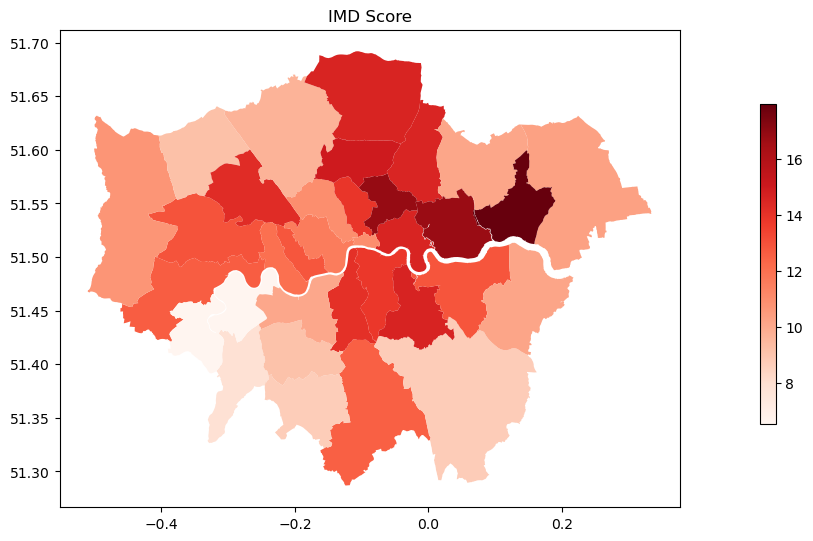

In [62]:
# GWR before
vmin, vmax = np.min(reg_gdf['IMD_score']), np.max(reg_gdf['IMD_score'])
ax = reg_gdf.plot(column='IMD_score', figsize=(8, 8), cmap='Reds', vmin=vmin, vmax=vmax)
ax.set_title('IMD Score')

fig = ax.get_figure()
cax = fig.add_axes([1.0, 0.3, 0.02, 0.4]) # the position and size of colormap legend bar
sm_price = plt.cm.ScalarMappable(norm=plt.Normalize(vmin=vmin, vmax=vmax), cmap='Reds')
sm_price._A = []
fig.colorbar(sm_price, cax=cax, extend='neither')
plt.show()

In [63]:
# GWR
# standardize the variables
X_std = []
for x in X:
    X_std.append((x - x.mean()) / x.std())

y_std = (y - y.mean()) / y.std()

#Prepare dataset inputs
g_y = y_std.reshape((-1,1))
g_X = np.column_stack(X_std).T


In [64]:
#Coordinates for calibration points
def getXY(pt):
    return (pt.x, pt.y)

centroidseries = reg_gdf['geometry'].centroid

u,v = [list(t) for t in zip(*map(getXY, centroidseries))]

coords = np.array(list(zip(u,v)))
g_coords = np.array(list(zip(u,v)))

C:\Users\kayla\AppData\Local\Temp\ipykernel_27972\2091816383.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroidseries = reg_gdf['geometry'].centroid


In [65]:
print(g_y.shape)
print(g_X.shape)
print(g_coords.shape)

(33, 1)
(33, 4)
(33, 2)


In [66]:
# Select bandwidth for kernel
bw = Sel_BW(g_coords, 
            g_y,
            g_X,
            fixed=False,
            spherical=True)
# calculate the optimum bandwidth for local regression
bw.search(bw_min=2)

26.0

In [67]:
model = GWR(coords, y_std, g_X, bw.bw[0])
results = model.fit()

d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):
d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):
d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):
d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) in

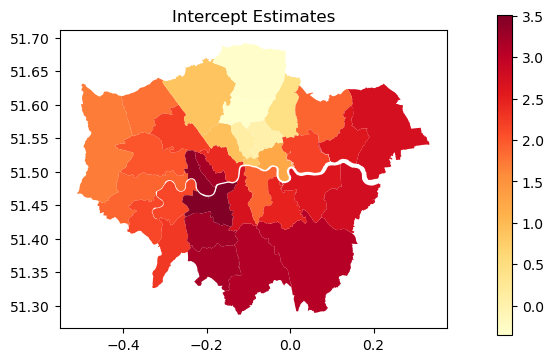

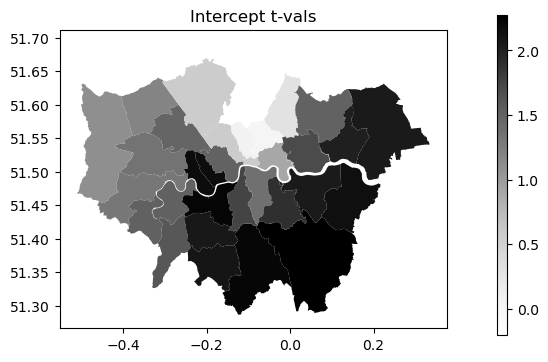

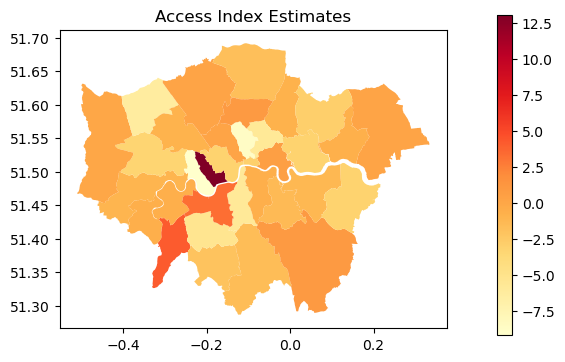

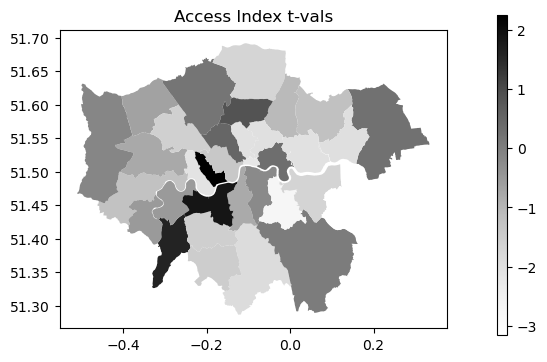

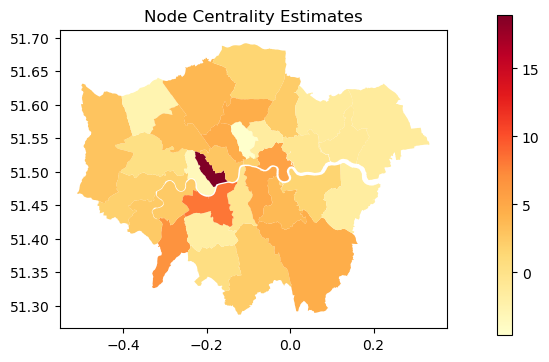

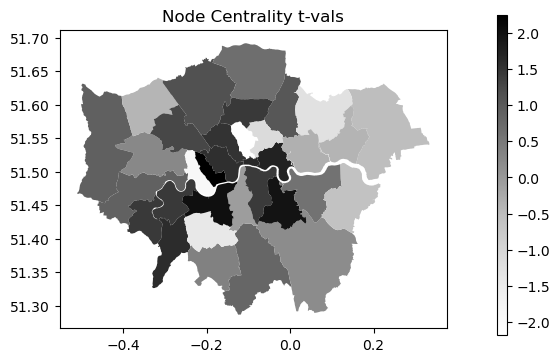

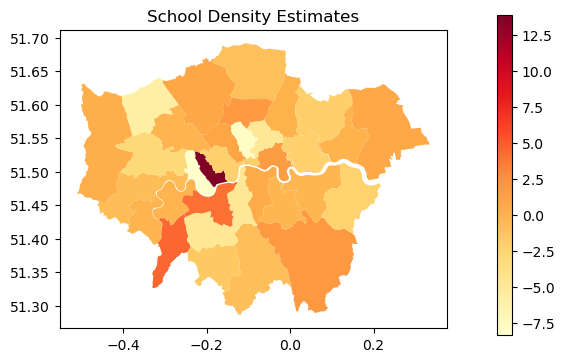

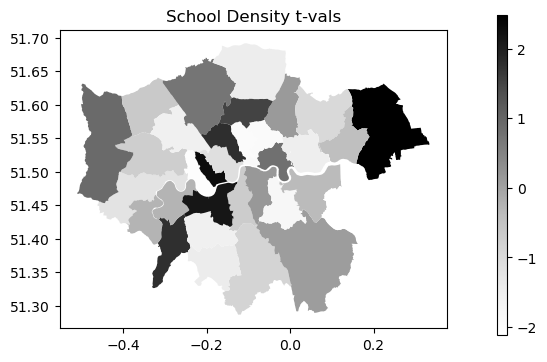

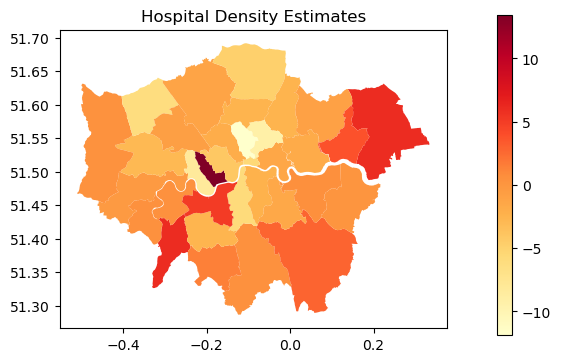

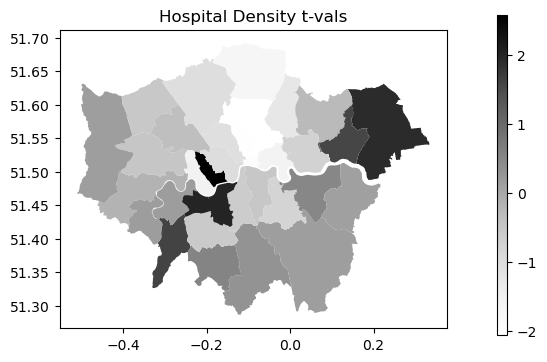

In [68]:
#Map Parameter estimates and T-vals for each covariate
labels = ['Intercept', 'Access Index', 'Node Centrality', 'School Density', 'Hospital Density']
for param in range(results.params.shape[1]):
    reg_gdf[str(param)] = results.params[:,param]
    vmin, vmax = np.min(reg_gdf[str(param)]), np.max(reg_gdf[str(param)]) 
    ax = reg_gdf.plot(str(param), vmin=vmin, vmax=vmax, figsize=(5,8), cmap='YlOrRd')
    ax.set_title(labels[param] + ' Estimates')
    fig = ax.get_figure()
    cax = fig.add_axes([1.0, 0.3, 0.03, 0.4])
    sm = plt.cm.ScalarMappable(norm=plt.Normalize(vmin=vmin, vmax=vmax), cmap='YlOrRd')
    sm._A = []
    fig.colorbar(sm, cax=cax)
    
    reg_gdf[str(param)] = results.tvalues[:,param]
    vmin, vmax = np.min(reg_gdf[str(param)]), np.max(reg_gdf[str(param)]) 
    ax = reg_gdf.plot(str(param), vmin=vmin, vmax=vmax, figsize=(5,8), cmap='Greys')
    ax.set_title(labels[param] + ' t-vals')
    fig = ax.get_figure()
    cax = fig.add_axes([1.0, 0.3, 0.02, 0.4])
    sm = plt.cm.ScalarMappable(norm=plt.Normalize(vmin=vmin, vmax=vmax), cmap='Greys')
    sm._A = []
    fig.colorbar(sm, cax=cax)

d:\Anaconda\envs\mscui2023\lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


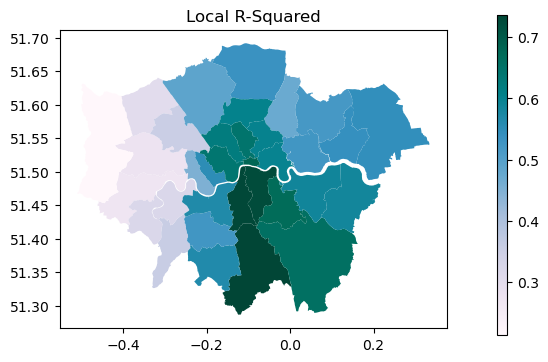

In [69]:
#Map local R-square values which is a weighted R-square at each observation location

reg_gdf['localR2'] = results.localR2
vmin, vmax = np.min(reg_gdf['localR2']), np.max(reg_gdf['localR2']) 
ax = reg_gdf.plot('localR2', vmin=vmin, vmax=vmax, figsize=(5,8), cmap='PuBuGn')
ax.set_title('Local R-Squared')
fig = ax.get_figure()
cax = fig.add_axes([1.0, 0.3, 0.02, 0.4])
sm = plt.cm.ScalarMappable(norm=plt.Normalize(vmin=vmin, vmax=vmax), cmap='PuBuGn')
sm._A = []
fig.colorbar(sm, cax=cax)

TFL API:
https://api-portal.tfl.gov.uk/api-details#api=stationdata&operation=detailed